In [1]:
%matplotlib inline
import copy
import numpy as np
import matplotlib.pyplot as plt
import torch
from p2ch13.dsets import getCandidateInfoList, getCt, TrainingLuna2dSegmentationDataset, CandidateInfoTuple
from p2ch13.model import SegmentationMask, MaskTuple
from p2ch13.vis import build2dLungMask
from util.util import xyz2irc

In [2]:
candidateInfo_list = getCandidateInfoList(requireOnDisk_bool=False)
candidateInfo_list[0]

CandidateInfoTuple(isNodule_bool=True, hasAnnotation_bool=True, isMal_bool=True, diameter_mm=32.27003025, series_uid='1.3.6.1.4.1.14519.5.2.1.6279.6001.287966244644280690737019247886', center_xyz=(67.82725575, 85.37992457, -109.74672379999998))

In [3]:
series_list = sorted(set(t.series_uid for t in candidateInfo_list))

In [4]:
ds = TrainingLuna2dSegmentationDataset(
            val_stride=10,
            isValSet_bool=False,
            contextSlices_count=3,
            # augmentation_dict=self.augmentation_dict,
        )

def _ds_iter():
    for i in range(len(ds)):
        yield ds[i]

ds_iter = _ds_iter()

2025-07-17 14:54:26,781 INFO     pid:8732 p2ch13.dsets:271:__init__ <p2ch13.dsets.TrainingLuna2dSegmentationDataset object at 0x000001C8AE28B8E0>: 799 training series, 8343 slices, 1028 nodules


In [5]:
def show_positive_slices_grid(uid, max_samples=9):
    dataset = TrainingLuna2dSegmentationDataset(series_uid=uid)
    ct = getCt(uid)

    candidate_list = getCandidateInfoList()

    # 이 UID에 해당하는 결절 정보만 추출 (슬라이스별로 여러 개도 고려)
    cand_per_slice = {}
    for cand in candidate_list:
        if cand.series_uid == uid and cand.isNodule_bool:
            center_irc = xyz2irc(cand.center_xyz, ct.origin_xyz, ct.vxSize_xyz, np.eye(3))  # direction_a → eye(3)
            slice_idx = int(round(center_irc[0]))
            if slice_idx not in cand_per_slice:
                cand_per_slice[slice_idx] = []
            cand_per_slice[slice_idx].append(cand.diameter_mm)

    # 시각화용 양성 슬라이스 수집
    positive_samples = []
    for i in range(len(dataset)):
        ct_t, mask_t, series_uid, slice_index = dataset[i]
        if mask_t.sum() > 0:
            diameters = cand_per_slice.get(slice_index, [])
            positive_samples.append((ct_t[0].numpy(), mask_t[0].numpy(), diameters, slice_index))
            if len(positive_samples) >= max_samples:
                break

    # 그리드 시각화
    num_samples = len(positive_samples)
    cols = 3
    rows = (num_samples + cols - 1) // cols
    fig, axs = plt.subplots(rows, cols, figsize=(12, 4 * rows))

    for i, (ct_slice, mask_slice, diameters, slice_index) in enumerate(positive_samples):
        r, c = divmod(i, cols)
        ax = axs[r][c] if rows > 1 else axs[c]
        ax.imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
        ax.imshow(mask_slice, cmap='Reds', alpha=0.3)
        
        if diameters:
            diam_str = ', '.join([f'{d:.1f}' for d in diameters])
            title = f'Slice {slice_index} (Nodule)\nDiam: {diam_str} mm'
        else:
            title = f'Slice {slice_index} (Nodule)'
        ax.set_title(title)
        ax.axis('off')

    # 빈칸 처리
    for j in range(num_samples, rows * cols):
        r, c = divmod(j, cols)
        ax = axs[r][c] if rows > 1 else axs[c]
        ax.axis('off')

    plt.tight_layout()
    plt.suptitle(f'Positive Nodule Slices - UID: {uid}', y=1.02)
    plt.show()

2025-07-17 14:54:26,865 INFO     pid:8732 p2ch13.dsets:271:__init__ <p2ch13.dsets.TrainingLuna2dSegmentationDataset object at 0x000001C89A8ABDF0>: 1 general series, 29 slices, 9 nodules


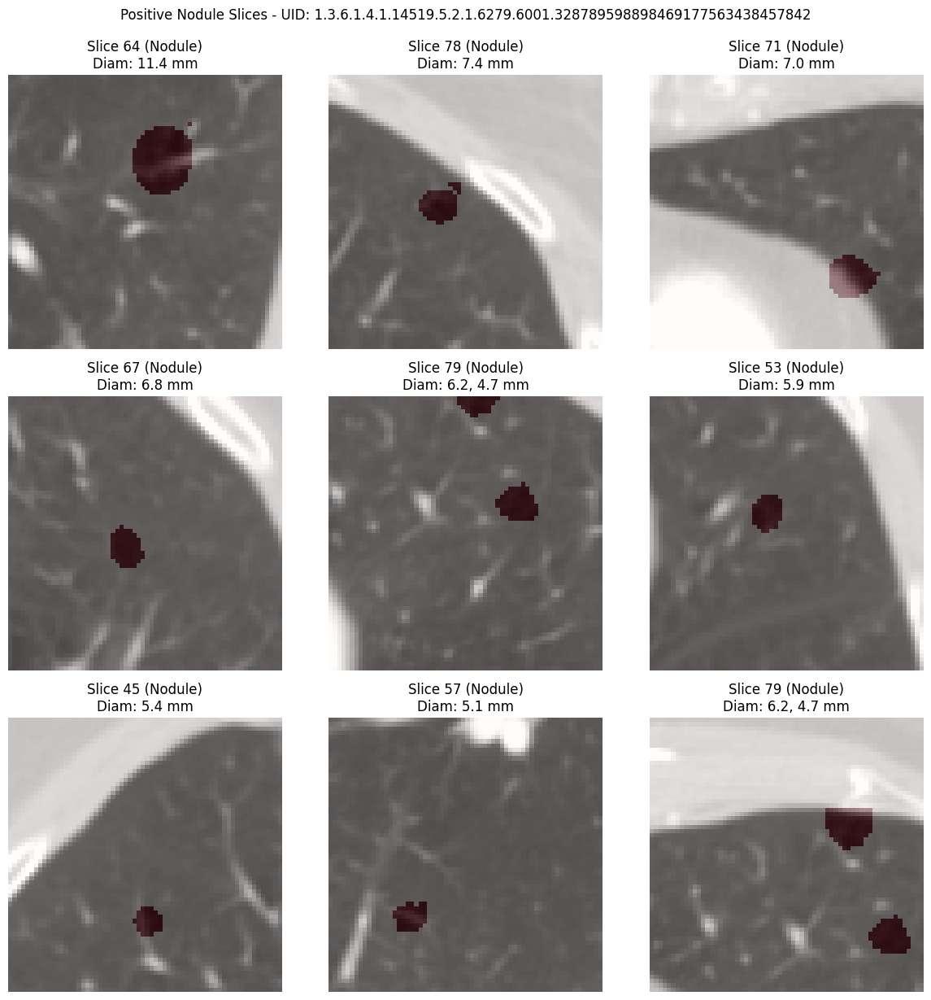

In [6]:
show_positive_slices_grid("1.3.6.1.4.1.14519.5.2.1.6279.6001.328789598898469177563438457842")

In [7]:
import torch
from p2ch13.model import UNetWrapper

#  정확한 인자 구성: wf=4 → 2^4 = 16, batch_norm=True → state와 일치
model = UNetWrapper(
    in_channels=7,
    n_classes=1,
    depth=3,
    wf=4,
    padding=False,
    batch_norm=True,
    up_mode='upconv'
)

#  state_dict 로딩
model_path = "data-unversioned/part2/models/p2ch13/seg_2025-07-15_09.20.51_none.3000000.state"
checkpoint = torch.load(model_path, map_location='cpu')
model.load_state_dict(checkpoint["model_state"])

#  디바이스 올리기
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)
model.eval()

UNetWrapper(
  (input_batchnorm): BatchNorm2d(7, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (unet): UNet(
    (down_path): ModuleList(
      (0): UNetConvBlock(
        (block): Sequential(
          (0): Conv2d(7, 16, kernel_size=(3, 3), stride=(1, 1))
          (1): ReLU()
          (2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (3): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1))
          (4): ReLU()
          (5): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
      )
      (1): UNetConvBlock(
        (block): Sequential(
          (0): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1))
          (1): ReLU()
          (2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1))
          (4): ReLU()
          (5): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running

In [8]:
def show_single_slice_with_masks(ct_tensor, mask_tensor, series_uid, slice_index, model, device, diameters=None, threshold=0.5):
    model.eval()
    with torch.no_grad():
        input_tensor = ct_tensor.unsqueeze(0).to(device)  # [1, 7, H, W]
        pred_mask = model(input_tensor).squeeze().cpu().numpy()  # [H, W]

    ct_slice = ct_tensor[3].numpy()
    gt_mask = mask_tensor[0].numpy() if mask_tensor.dim() == 3 else mask_tensor.numpy()

    fig, axs = plt.subplots(1, 3, figsize=(15, 5))

    axs[0].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
    axs[0].set_title(f"Slice {slice_index} - CT")
    axs[0].axis('off')

    axs[1].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
    axs[1].imshow(gt_mask, cmap='Reds', alpha=0.3)
    title = f"Ground Truth"
    if diameters:
        title += f"\nDiameter: {', '.join([f'{d:.1f}mm' for d in diameters])}"
    axs[1].set_title(title)
    axs[1].axis('off')

    axs[2].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
    axs[2].imshow(pred_mask > threshold, cmap='Blues', alpha=0.3)
    axs[2].set_title(f"Model Prediction\n(Threshold: {threshold})")
    axs[2].axis('off')

    plt.tight_layout()
    plt.suptitle(f"{series_uid}", y=1.05)
    plt.show()

In [9]:
from p2ch13.dsets import TrainingLuna2dSegmentationDataset

# 원하는 series_uid로 설정하거나 None으로 전체 사용
series_uid = "1.3.6.1.4.1.14519.5.2.1.6279.6001.328789598898469177563438457842"

# Dataset 정의
dataset = TrainingLuna2dSegmentationDataset(series_uid=series_uid)

2025-07-17 14:54:27,662 INFO     pid:8732 p2ch13.dsets:271:__init__ <p2ch13.dsets.TrainingLuna2dSegmentationDataset object at 0x000001C88E487040>: 1 general series, 29 slices, 9 nodules


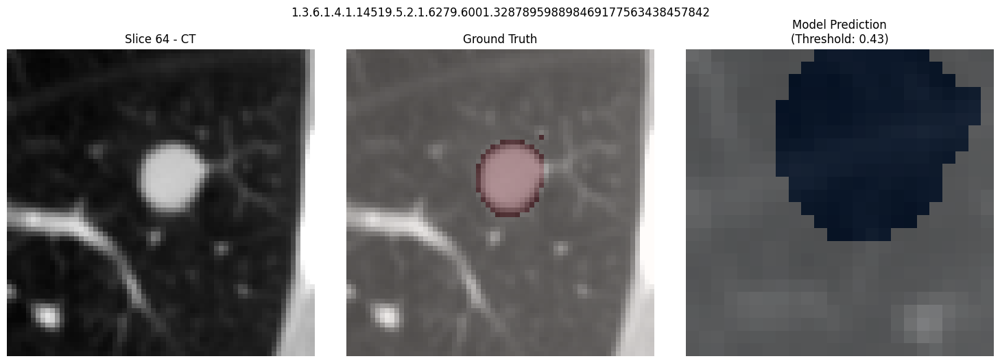

In [10]:
ct_tensor, mask_tensor, series_uid, slice_index = dataset[0]

show_single_slice_with_masks(ct_tensor, mask_tensor, series_uid, slice_index, model, device, threshold=0.43)

In [11]:
from scipy.ndimage import zoom

def show_tp_fp_fn(ct_tensor, mask_tensor, series_uid, slice_index, model, device, threshold=0.5):

    model.eval()
    with torch.no_grad():
        input_tensor = ct_tensor.unsqueeze(0).to(device)  # [1, 7, H, W]
        pred_mask = model(input_tensor).squeeze().cpu().numpy()  # [h_pred, w_pred]

    # 정답 마스크와 크기 맞추기
    gt_mask = mask_tensor[0].numpy() if mask_tensor.ndim == 3 else mask_tensor.numpy()  # [H, W]
    if pred_mask.shape != gt_mask.shape:
        pred_mask = zoom(pred_mask,
                         (gt_mask.shape[0] / pred_mask.shape[0],
                          gt_mask.shape[1] / pred_mask.shape[1]),
                         order=1)

    # Thresholding
    binary_pred = pred_mask > threshold

    # TP / FP / FN 계산
    tp = (binary_pred == 1) & (gt_mask == 1)
    fp = (binary_pred == 1) & (gt_mask == 0)
    fn = (binary_pred == 0) & (gt_mask == 1)

    # RGB 마스크 생성
    vis_mask = np.zeros((*gt_mask.shape, 3), dtype=np.uint8)
    vis_mask[tp] = [0, 255, 0]     # 초록
    vis_mask[fp] = [0, 0, 255]     # 파랑
    vis_mask[fn] = [255, 0, 0]     # 빨강

    # CT 슬라이스 추출
    ct_slice = ct_tensor[3].numpy()  # 중앙 슬라이스 사용

    # 시각화
    fig, axs = plt.subplots(1, 2, figsize=(12, 5))

    axs[0].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
    axs[0].set_title(f"CT Slice (index={slice_index})")
    axs[0].axis('off')

    axs[1].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
    axs[1].imshow(vis_mask, alpha=0.5)
    axs[1].set_title(f"TP(G) / FP(B) / FN(R)\n(Threshold: {threshold})")
    axs[1].axis('off')

    plt.tight_layout()
    plt.suptitle(f"{series_uid}", y=1.05)
    plt.show()

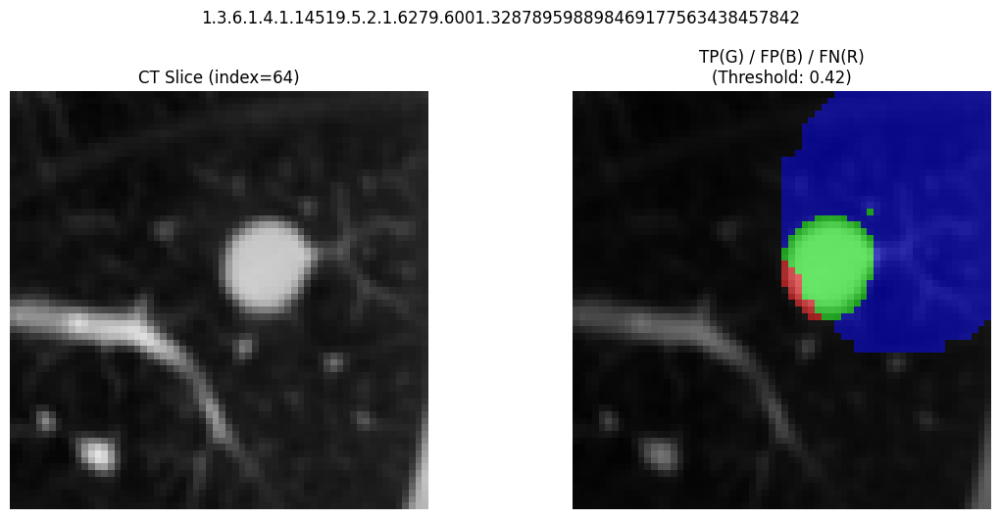

In [12]:
ct_tensor, mask_tensor, series_uid, slice_index = dataset[0]

show_tp_fp_fn(ct_tensor, mask_tensor, series_uid, slice_index, model, device, threshold=0.42)

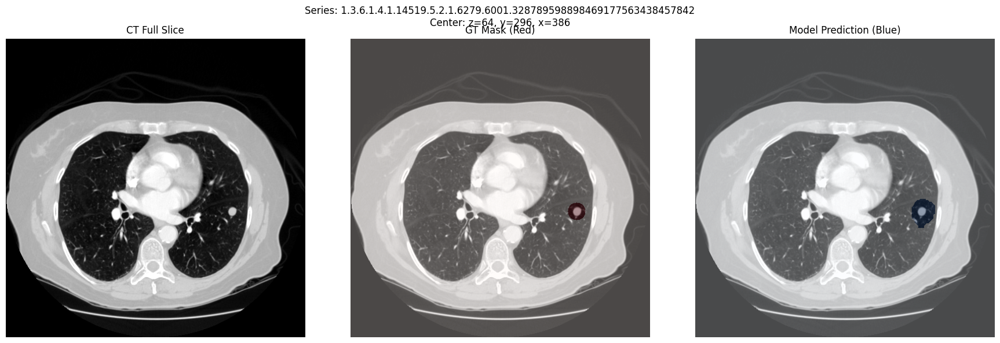

<Figure size 640x480 with 0 Axes>

In [13]:
from util.util import xyz2irc
from p2ch14.dsets import getCt
import matplotlib.pyplot as plt
from p2ch14.dsets import getCandidateInfoList
import torch.nn.functional as F
# 🔹 원하는 UID 지정 (예시)
series_uid = "1.3.6.1.4.1.14519.5.2.1.6279.6001.328789598898469177563438457842"

# 🔹 후보 리스트 불러오기
candidate_list = getCandidateInfoList()

# 🔹 해당 UID의 양성 결절 하나 선택
candidate = [c for c in candidate_list if c.series_uid == series_uid and c.isNodule_bool][0]

# 🔹 CT 객체 로딩
ct = getCt(series_uid)


# 🔹 중심 슬라이스 (결절 z좌표)
center_irc = xyz2irc(candidate.center_xyz, ct.origin_xyz, ct.vxSize_xyz, ct.direction_a)
z, y, x = map(int, center_irc)

# 🔹 CT 원본 슬라이스 (full view)
ct_slice = ct.hu_a[z]  # [H, W], full 512×512 슬라이스

# 🔹 GT 마스크 → 보통 결절 반경을 기반으로 원 만들어 씌움 (간이 구현)
gt_mask = np.zeros_like(ct_slice, dtype=np.uint8)
r = max(3, int(candidate.diameter_mm / ct.vxSize_xyz[1]))  # 픽셀 단위 반지름
yy, xx = np.ogrid[:ct_slice.shape[0], :ct_slice.shape[1]]
mask_area = (yy - y)**2 + (xx - x)**2 <= r**2
gt_mask[mask_area] = 1

# 🔹 모델 예측 → 기존처럼 64x64 crop해서 수행 후 해당 위치에 다시 붙이기
crop = ct.hu_a[z - 3:z + 4, y - 32:y + 32, x - 32:x + 32]  # [7, 64, 64]
input_tensor = torch.from_numpy(crop).unsqueeze(0).to(device)
model.eval()
with torch.no_grad():
    pred = model(input_tensor)  # [1, 1, H, W]
    pred_resized = F.interpolate(pred, size=(64, 64), mode='bilinear', align_corners=False)
    pred_mask = pred_resized.squeeze().cpu().numpy() > 0.5  # binary

# 🔹 예측 마스크를 512x512 위에 다시 위치시키기
pred_full = np.zeros_like(ct_slice, dtype=np.uint8)
pred_full[y - 32:y + 32, x - 32:x + 32] = pred_mask

# 🔹 시각화 (Full Slice + GT + Pred)
fig, axs = plt.subplots(1, 3, figsize=(18, 6))

axs[0].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
axs[0].set_title("CT Full Slice")

axs[1].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
axs[1].imshow(gt_mask, cmap='Reds', alpha=0.3)
axs[1].set_title("GT Mask (Red)")

axs[2].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
axs[2].imshow(pred_full, cmap='Blues', alpha=0.3)
axs[2].set_title("Model Prediction (Blue)")

for ax in axs:
    ax.axis('off')

plt.suptitle(f"Series: {series_uid}\nCenter: z={z}, y={y}, x={x}")
plt.tight_layout()
plt.show()
for ax in axs:
    ax.axis('off')

plt.suptitle(f"Series: {series_uid}\nCenter: z={z}, y={y}, x={x}")
plt.tight_layout()
plt.show()

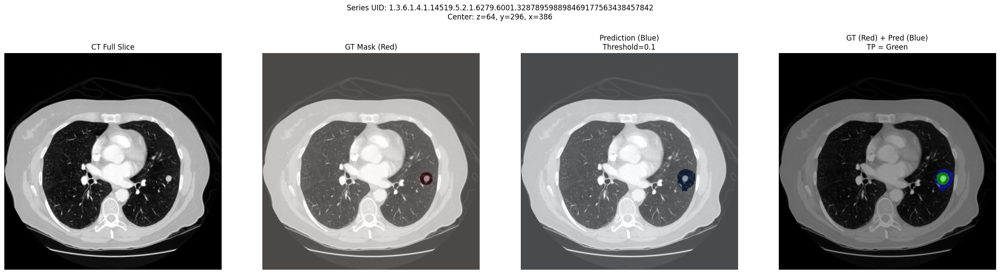

In [14]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import torch.nn.functional as F
from util.util import xyz2irc
from p2ch14.dsets import getCt, getCandidateInfoList

# -------------------------
# 설정
# -------------------------
series_uid = "1.3.6.1.4.1.14519.5.2.1.6279.6001.328789598898469177563438457842"
threshold = 0.1 # 🔸 임계값 설정

# -------------------------
# CT 및 결절 위치 정보
# -------------------------
candidate = [c for c in getCandidateInfoList() if c.series_uid == series_uid and c.isNodule_bool][0]
ct = getCt(series_uid)
center_irc = xyz2irc(candidate.center_xyz, ct.origin_xyz, ct.vxSize_xyz, ct.direction_a)
z, y, x = map(int, center_irc)
ct_slice = ct.hu_a[z]  # [H, W] 슬라이스

# -------------------------
# GT 마스크 생성 (원형)
# -------------------------
gt_mask = np.zeros_like(ct_slice, dtype=np.uint8)
r = max(3, int(candidate.diameter_mm / ct.vxSize_xyz[1]))  # mm → 픽셀
yy, xx = np.ogrid[:ct_slice.shape[0], :ct_slice.shape[1]]
mask_area = (yy - y)**2 + (xx - x)**2 <= r**2
gt_mask[mask_area] = 1

# -------------------------
# 모델 예측 (결절 주변 crop → 예측 → 다시 붙이기)
# -------------------------
crop = ct.hu_a[z - 3:z + 4, y - 32:y + 32, x - 32:x + 32]  # [7, 64, 64]
input_tensor = torch.from_numpy(crop).unsqueeze(0).to(device)
model.eval()
with torch.no_grad():
    pred = model(input_tensor)  # [1, 1, h, w]
    pred_resized = F.interpolate(pred, size=(64, 64), mode='bilinear', align_corners=False)
    pred_mask = pred_resized.squeeze().cpu().numpy() > threshold  # 🔸 threshold 적용

# 512x512로 다시 위치 맞추기
pred_full = np.zeros_like(ct_slice, dtype=np.uint8)
pred_full[y - 32:y + 32, x - 32:x + 32] = pred_mask

# -------------------------
# GT + PRED 중첩 → TP: 초록색
# -------------------------
overlay = np.zeros((*ct_slice.shape, 3), dtype=np.uint8)
overlay[gt_mask == 1] = [255, 0, 0]         # GT: Red
overlay[pred_full == 1] = [0, 0, 255]       # Pred: Blue
overlay[(gt_mask == 1) & (pred_full == 1)] = [0, 255, 0]  # TP: Green

# -------------------------
# 시각화
# -------------------------
fig, axs = plt.subplots(1, 4, figsize=(24, 6))

axs[0].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
axs[0].set_title("CT Full Slice")

axs[1].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
axs[1].imshow(gt_mask, cmap='Reds', alpha=0.3)
axs[1].set_title("GT Mask (Red)")

axs[2].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
axs[2].imshow(pred_full, cmap='Blues', alpha=0.3)
axs[2].set_title(f"Prediction (Blue)\nThreshold={threshold}")

axs[3].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
axs[3].imshow(overlay, alpha=0.4)
axs[3].set_title("GT (Red) + Pred (Blue)\nTP = Green")

for ax in axs:
    ax.axis('off')

plt.suptitle(f"Series UID: {series_uid}\nCenter: z={z}, y={y}, x={x}", y=1.05)
plt.tight_layout()
plt.show()

2025-07-17 14:54:33,581 WARNING  pid:8732 matplotlib.image:661:_normalize_image_array Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1000.0..1000.0].
2025-07-17 14:54:33,581 WARNING  pid:8732 matplotlib.image:661:_normalize_image_array Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1000.0..1000.0].


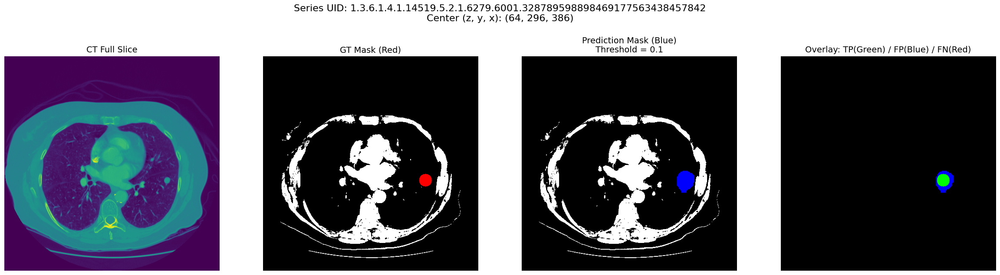

In [15]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import torch.nn.functional as F
from util.util import xyz2irc
from p2ch14.dsets import getCt, getCandidateInfoList

# -------------------------
# 설정
# -------------------------
series_uid = "1.3.6.1.4.1.14519.5.2.1.6279.6001.328789598898469177563438457842"
threshold = 0.1
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# -------------------------
# CT 및 결절 위치
# -------------------------
candidate = [c for c in getCandidateInfoList() if c.series_uid == series_uid and c.isNodule_bool][0]
ct = getCt(series_uid)
center_irc = xyz2irc(candidate.center_xyz, ct.origin_xyz, ct.vxSize_xyz, ct.direction_a)
z, y, x = map(int, center_irc)
ct_slice = ct.hu_a[z]  # [H, W]

# -------------------------
# GT 마스크 생성 (원형)
# -------------------------
gt_mask = np.zeros_like(ct_slice, dtype=np.uint8)
r = max(3, int(candidate.diameter_mm / ct.vxSize_xyz[1]))  # mm → pixel
yy, xx = np.ogrid[:ct_slice.shape[0], :ct_slice.shape[1]]
mask_area = (yy - y)**2 + (xx - x)**2 <= r**2
gt_mask[mask_area] = 1

# -------------------------
# 모델 예측
# -------------------------
crop = ct.hu_a[z - 3:z + 4, y - 32:y + 32, x - 32:x + 32]
input_tensor = torch.from_numpy(crop).unsqueeze(0).to(device)
model.eval()
with torch.no_grad():
    pred = model(input_tensor)  # [1, 1, h, w]
    pred_resized = F.interpolate(pred, size=(64, 64), mode='bilinear', align_corners=False)
    pred_mask = pred_resized.squeeze().cpu().numpy() > threshold

# 다시 512x512로 위치 맞추기
pred_full = np.zeros_like(ct_slice, dtype=np.uint8)
pred_full[y - 32:y + 32, x - 32:x + 32] = pred_mask

# -------------------------
# Overlay 생성 (TP = Green, FP = Blue, FN = Red)
# -------------------------
overlay = np.zeros((*ct_slice.shape, 3), dtype=np.uint8)
overlay[(gt_mask == 1) & (pred_full == 1)] = [0, 255, 0]   # TP → Green
overlay[(gt_mask == 0) & (pred_full == 1)] = [0, 0, 255]   # FP → Blue
overlay[(gt_mask == 1) & (pred_full == 0)] = [255, 0, 0]   # FN → Red

# -------------------------
# 시각화
# -------------------------
fig, axs = plt.subplots(1, 4, figsize=(24, 6))

titles = [
    "CT Full Slice",
    "GT Mask (Red)",
    f"Prediction Mask (Blue)\nThreshold = {threshold}",
    "Overlay: TP(Green) / FP(Blue) / FN(Red)"
]

images = [
    ct_slice,
    np.stack([ct_slice] * 3, axis=-1),
    np.stack([ct_slice] * 3, axis=-1),
    np.stack([ct_slice] * 3, axis=-1)
]

# GT
gt_overlay = images[1].copy()
gt_overlay[gt_mask == 1] = [255, 0, 0]
# PRED
pred_overlay = images[2].copy()
pred_overlay[pred_full == 1] = [0, 0, 255]

# 시각화 배열 지정
visuals = [ct_slice, gt_overlay, pred_overlay, overlay]

for i, ax in enumerate(axs):
    ax.imshow(visuals[i], cmap=None if i == 0 else 'gray')
    ax.set_title(titles[i], fontsize=14)
    ax.axis('off')

plt.suptitle(f"Series UID: {series_uid}\nCenter (z, y, x): ({z}, {y}, {x})", fontsize=16, y=1.05)
plt.tight_layout()
plt.show()

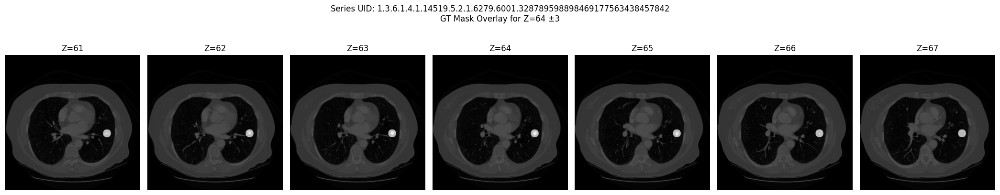

In [16]:
import torch
import matplotlib.pyplot as plt
import numpy as np
from util.util import xyz2irc
from p2ch14.dsets import getCandidateInfoList, getCt

# 🔹 대상 환자 및 결절 선택
series_uid = "1.3.6.1.4.1.14519.5.2.1.6279.6001.328789598898469177563438457842"
candidate_list = getCandidateInfoList()
candidate = [c for c in candidate_list if c.series_uid == series_uid and c.isNodule_bool][0]
ct = getCt(series_uid)

# 🔹 중심 좌표
center_irc = xyz2irc(candidate.center_xyz, ct.origin_xyz, ct.vxSize_xyz, ct.direction_a)
z_center, y_center, x_center = map(int, center_irc)

# 🔹 시각화: 중심 z기준 ±3 슬라이스, 총 7장
fig, axs = plt.subplots(1, 7, figsize=(21, 4))

# 픽셀 반지름
r = max(3, int(candidate.diameter_mm / ct.vxSize_xyz[1]))
yy, xx = np.ogrid[:512, :512]  # 슬라이스 크기

for i, z in enumerate(range(z_center - 3, z_center + 4)):
    ct_slice = ct.hu_a[z]
    
    # GT 마스크
    gt_mask = np.zeros_like(ct_slice, dtype=np.uint8)
    mask_area = (yy - y_center)**2 + (xx - x_center)**2 <= r**2
    gt_mask[mask_area] = 1

    # 흰색 마스크 만들기
    white_mask = np.zeros((*gt_mask.shape, 3), dtype=np.uint8)
    white_mask[gt_mask == 1] = [255, 255, 255]  # 흰색

    axs[i].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
    axs[i].imshow(white_mask, alpha=0.7)  # 투명도 조절 가능
    axs[i].set_title(f"Z={z}")
    axs[i].axis('off')

plt.suptitle(f"Series UID: {series_uid}\nGT Mask Overlay for Z={z_center} ±3", y=1.05)
plt.tight_layout()
plt.show()


[INFO] 총 양성 결절 수: 9


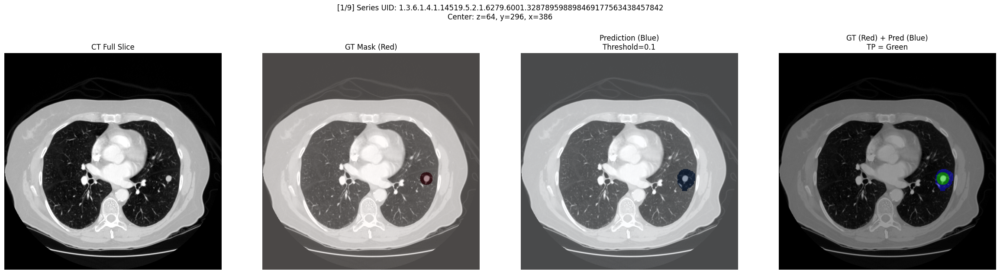

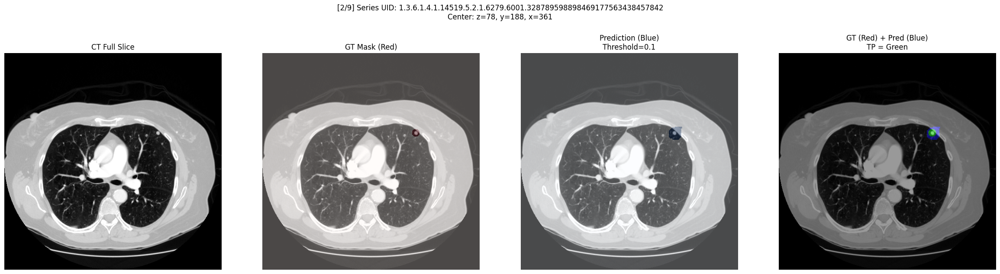

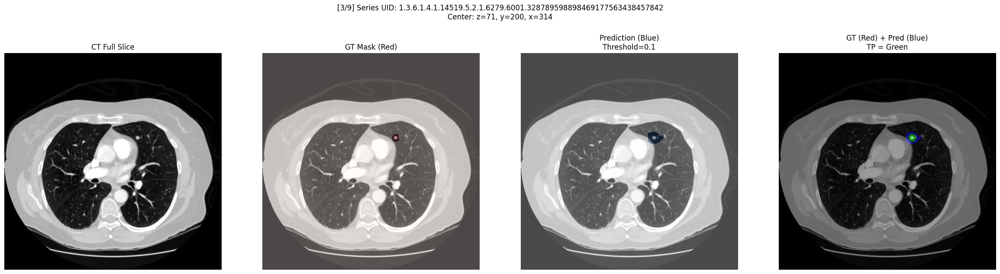

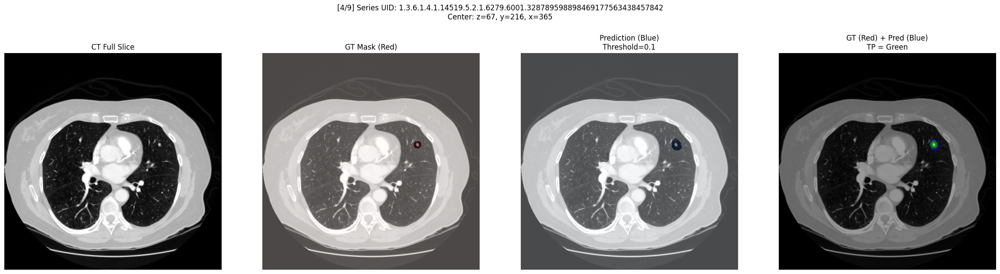

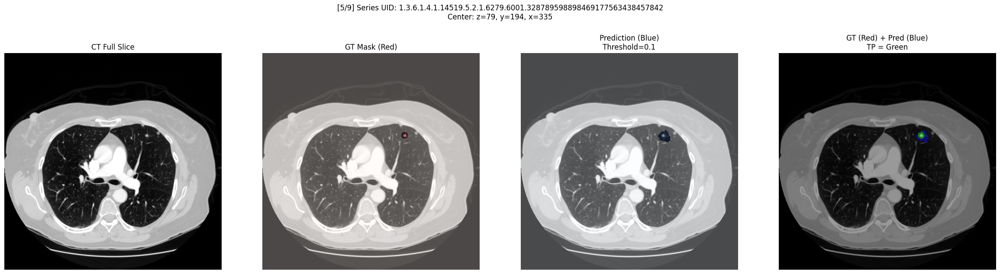

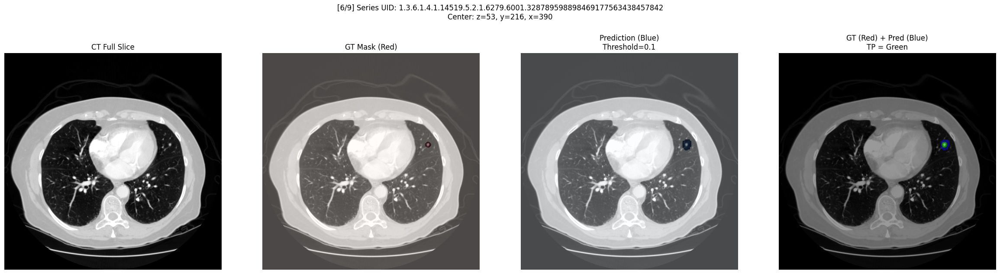

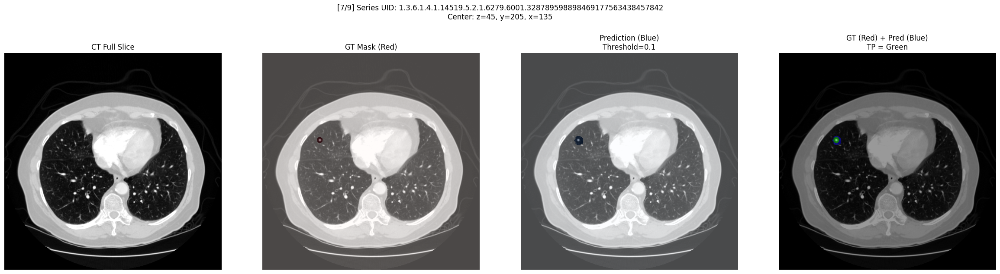

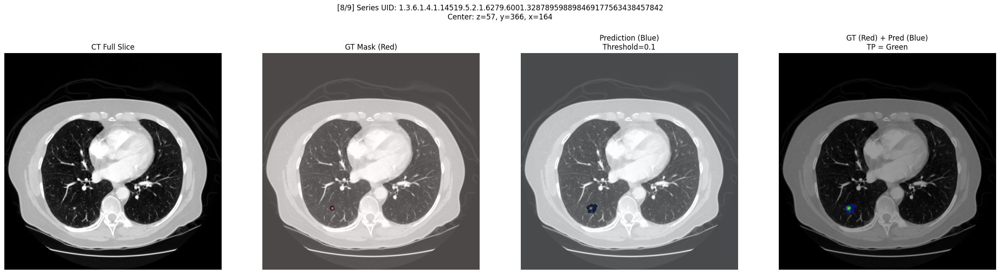

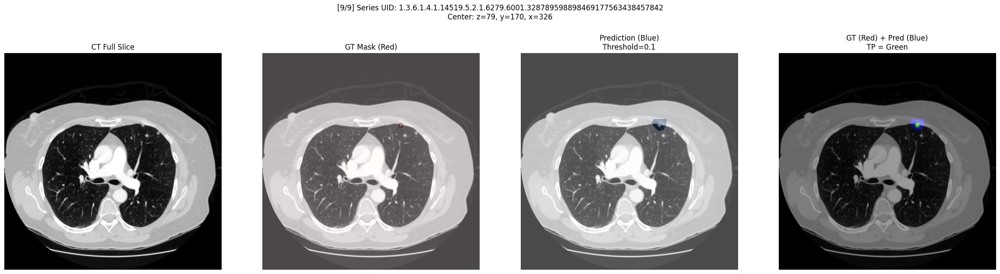

In [17]:
# -------------------------
# 설정
# -------------------------
series_uid = "1.3.6.1.4.1.14519.5.2.1.6279.6001.328789598898469177563438457842"
threshold = 0.1  # 임계값

# -------------------------
# CT 로드
# -------------------------
ct = getCt(series_uid)

# -------------------------
# 결절 리스트 (양성만)
# -------------------------
candidate_list = [c for c in getCandidateInfoList() if c.series_uid == series_uid and c.isNodule_bool]

print(f"[INFO] 총 양성 결절 수: {len(candidate_list)}")

# -------------------------
# 결절별 반복
# -------------------------
for idx, candidate in enumerate(candidate_list):
    center_irc = xyz2irc(candidate.center_xyz, ct.origin_xyz, ct.vxSize_xyz, ct.direction_a)
    z, y, x = map(int, center_irc)
    ct_slice = ct.hu_a[z]

    # GT 마스크
    gt_mask = np.zeros_like(ct_slice, dtype=np.uint8)
    r = max(3, int(candidate.diameter_mm / ct.vxSize_xyz[1]))
    yy, xx = np.ogrid[:ct_slice.shape[0], :ct_slice.shape[1]]
    mask_area = (yy - y)**2 + (xx - x)**2 <= r**2
    gt_mask[mask_area] = 1

    # 모델 예측
    crop = ct.hu_a[z - 3:z + 4, y - 32:y + 32, x - 32:x + 32]  # [7, 64, 64]
    input_tensor = torch.from_numpy(crop).unsqueeze(0).to(device)
    model.eval()
    with torch.no_grad():
        pred = model(input_tensor)
        pred_resized = F.interpolate(pred, size=(64, 64), mode='bilinear', align_corners=False)
        pred_mask = pred_resized.squeeze().cpu().numpy() > threshold

    pred_full = np.zeros_like(ct_slice, dtype=np.uint8)
    pred_full[y - 32:y + 32, x - 32:x + 32] = pred_mask

    # 중첩 마스크: 빨강 + 파랑 + 초록
    overlay = np.zeros((*ct_slice.shape, 3), dtype=np.uint8)
    overlay[gt_mask == 1] = [255, 0, 0]
    overlay[pred_full == 1] = [0, 0, 255]
    overlay[(gt_mask == 1) & (pred_full == 1)] = [0, 255, 0]

    # 시각화
    fig, axs = plt.subplots(1, 4, figsize=(24, 6))

    axs[0].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
    axs[0].set_title("CT Full Slice")

    axs[1].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
    axs[1].imshow(gt_mask, cmap='Reds', alpha=0.3)
    axs[1].set_title("GT Mask (Red)")

    axs[2].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
    axs[2].imshow(pred_full, cmap='Blues', alpha=0.3)
    axs[2].set_title(f"Prediction (Blue)\nThreshold={threshold}")

    axs[3].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
    axs[3].imshow(overlay, alpha=0.4)
    axs[3].set_title("GT (Red) + Pred (Blue)\nTP = Green")

    for ax in axs:
        ax.axis('off')

    plt.suptitle(f"[{idx+1}/{len(candidate_list)}] Series UID: {series_uid}\nCenter: z={z}, y={y}, x={x}", y=1.05)
    plt.tight_layout()
    plt.show()

[INFO] 검증셋 양성 결절 수: 119


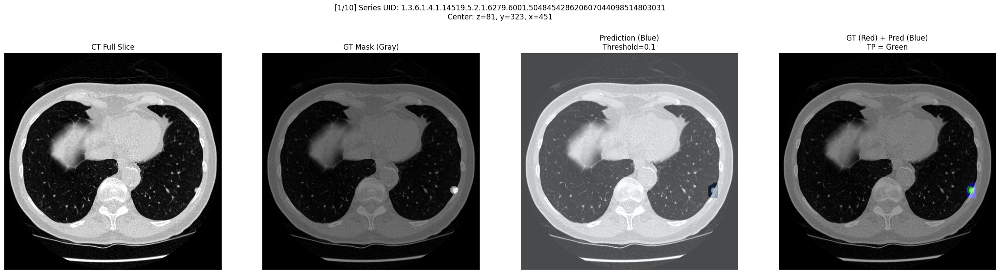

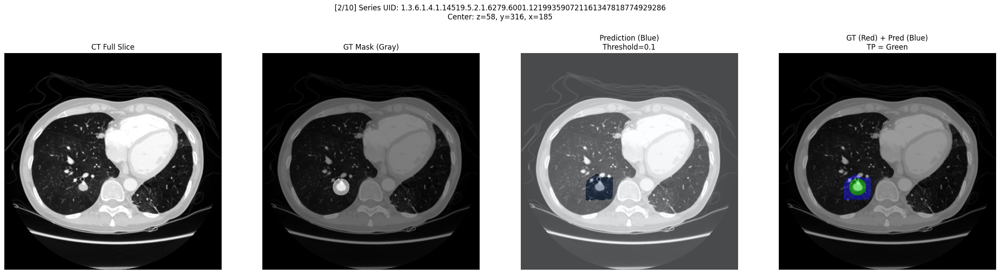

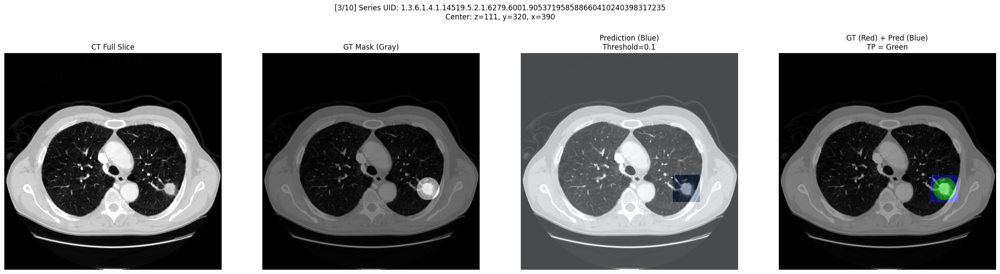

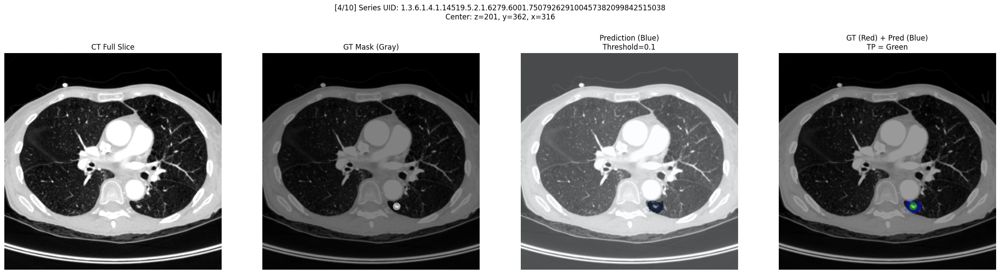

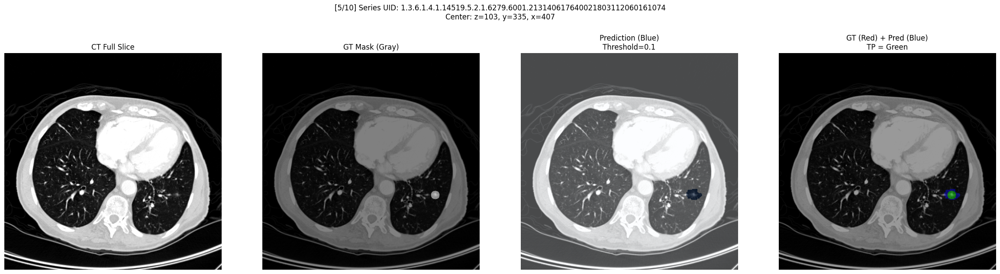

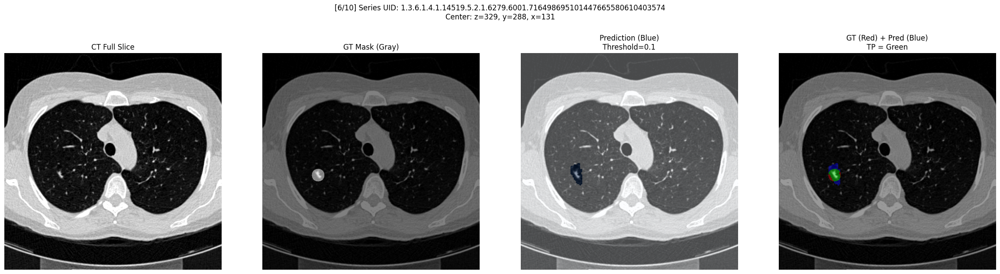

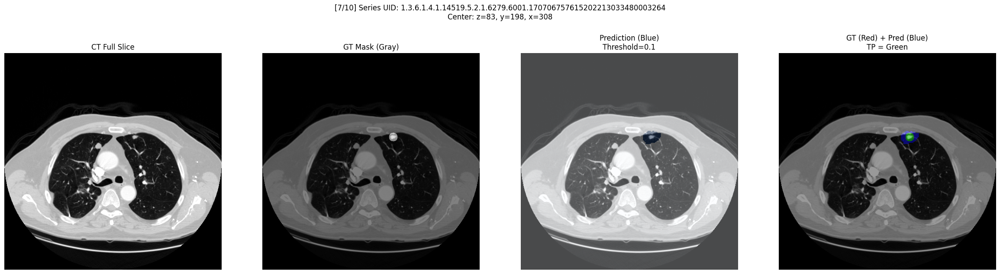

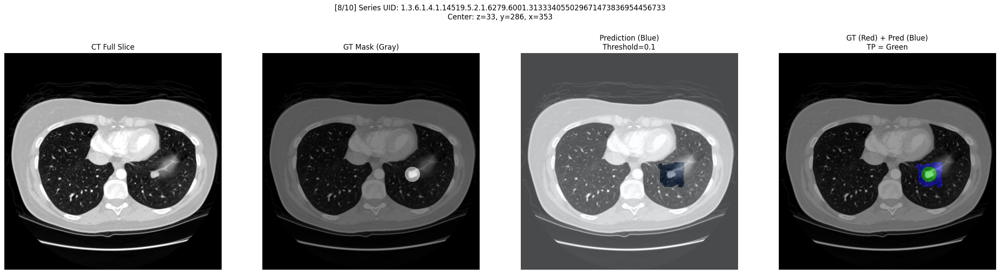

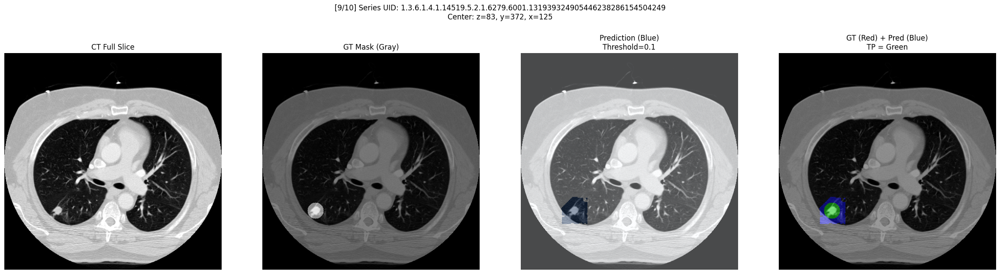

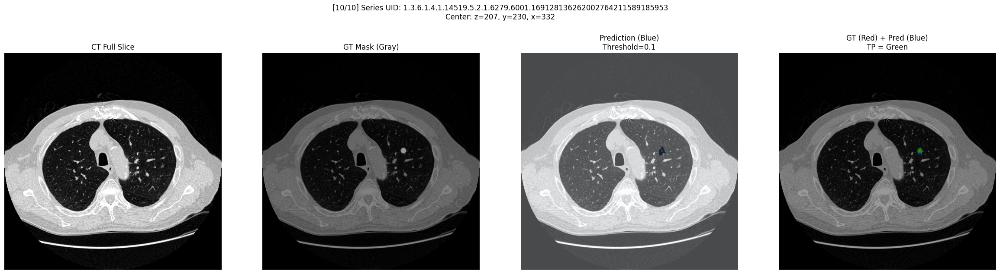

In [18]:
import torch
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
import random
from p2ch14.dsets import getCandidateInfoList, getCt
from util.util import xyz2irc

# -------------------------
# 설정
# -------------------------
val_stride = 10
threshold = 0.1
num_samples = 10
random.seed(42)  # 재현성 고정

# -------------------------
# 검증셋 양성 결절 리스트
# -------------------------
val_candidates = [
    c for i, c in enumerate(getCandidateInfoList())
    if i % val_stride == 0 and c.isNodule_bool
]

print(f"[INFO] 검증셋 양성 결절 수: {len(val_candidates)}")

# -------------------------
# 랜덤으로 N개 선택
# -------------------------
selected_candidates = random.sample(val_candidates, min(num_samples, len(val_candidates)))

# -------------------------
# 반복 시각화
# -------------------------
for idx, candidate in enumerate(selected_candidates):
    series_uid = candidate.series_uid
    ct = getCt(series_uid)

    center_irc = xyz2irc(candidate.center_xyz, ct.origin_xyz, ct.vxSize_xyz, ct.direction_a)
    z, y, x = map(int, center_irc)
    ct_slice = ct.hu_a[z]

    # GT 마스크
    gt_mask = np.zeros_like(ct_slice, dtype=np.uint8)
    r = max(3, int(candidate.diameter_mm / ct.vxSize_xyz[1]))
    yy, xx = np.ogrid[:ct_slice.shape[0], :ct_slice.shape[1]]
    mask_area = (yy - y)**2 + (xx - x)**2 <= r**2
    gt_mask[mask_area] = 1

    # 모델 예측
    crop = ct.hu_a[z - 3:z + 4, y - 32:y + 32, x - 32:x + 32]
    input_tensor = torch.from_numpy(crop).unsqueeze(0).to(device)

    model.eval()
    with torch.no_grad():
        pred = model(input_tensor)
        pred_resized = F.interpolate(pred, size=(64, 64), mode='bilinear', align_corners=False)
        pred_mask = pred_resized.squeeze().cpu().numpy() > threshold

    pred_full = np.zeros_like(ct_slice, dtype=np.uint8)
    pred_full[y - 32:y + 32, x - 32:x + 32] = pred_mask

    # 중첩 마스크
    overlay = np.zeros((*ct_slice.shape, 3), dtype=np.uint8)
    overlay[gt_mask == 1] = [255, 0, 0]
    overlay[pred_full == 1] = [0, 0, 255]
    overlay[(gt_mask == 1) & (pred_full == 1)] = [0, 255, 0]

    # 시각화
    fig, axs = plt.subplots(1, 4, figsize=(24, 6))

    axs[0].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
    axs[0].set_title("CT Full Slice")

    axs[1].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
    axs[1].imshow(gt_mask, cmap='gray', alpha=0.5)
    axs[1].set_title("GT Mask (Gray)")

    axs[2].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
    axs[2].imshow(pred_full, cmap='Blues', alpha=0.3)
    axs[2].set_title(f"Prediction (Blue)\nThreshold={threshold}")

    axs[3].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
    axs[3].imshow(overlay, alpha=0.4)
    axs[3].set_title("GT (Red) + Pred (Blue)\nTP = Green")

    for ax in axs:
        ax.axis('off')

    plt.suptitle(f"[{idx+1}/{len(selected_candidates)}] Series UID: {series_uid}\nCenter: z={z}, y={y}, x={x}", y=1.05)
    plt.tight_layout()
    plt.show()


[INFO] 검증셋 음성 후보 수: 54971


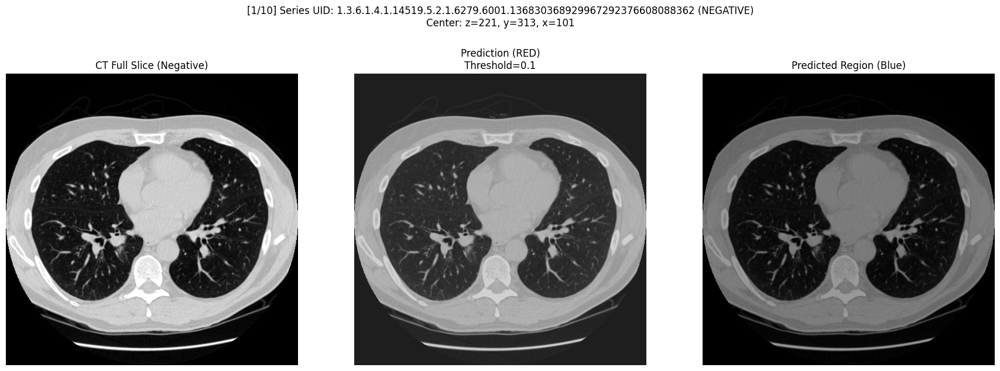

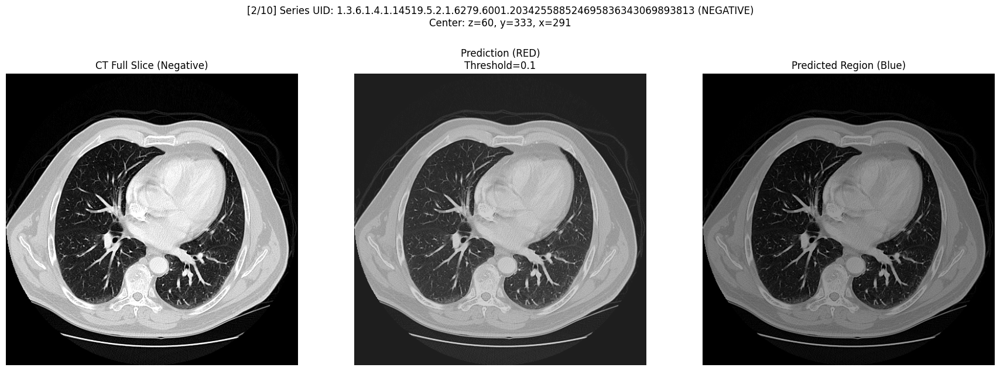

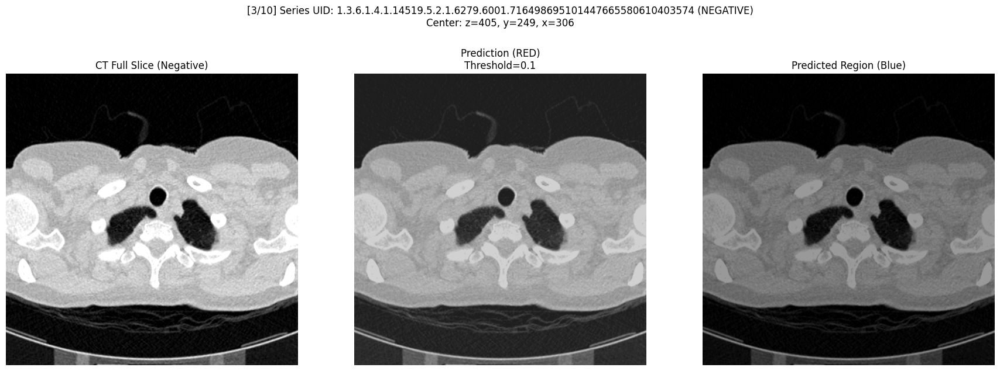

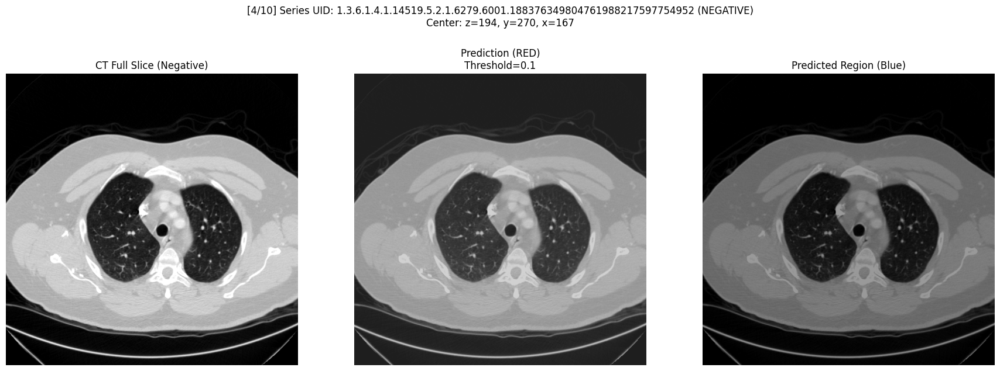

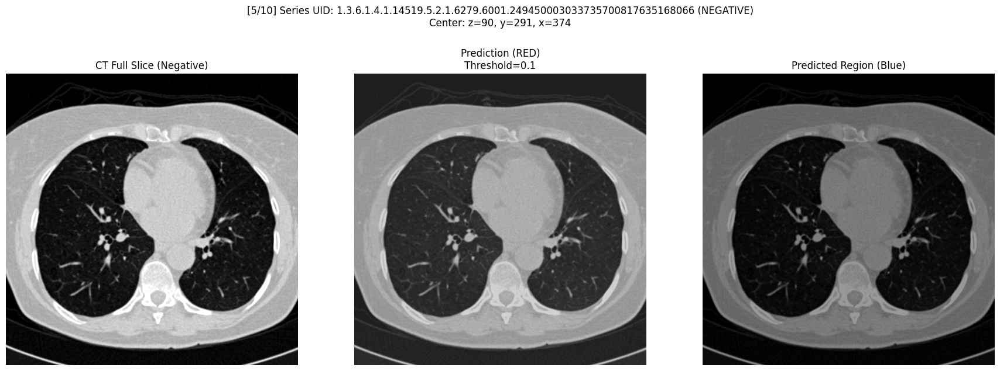

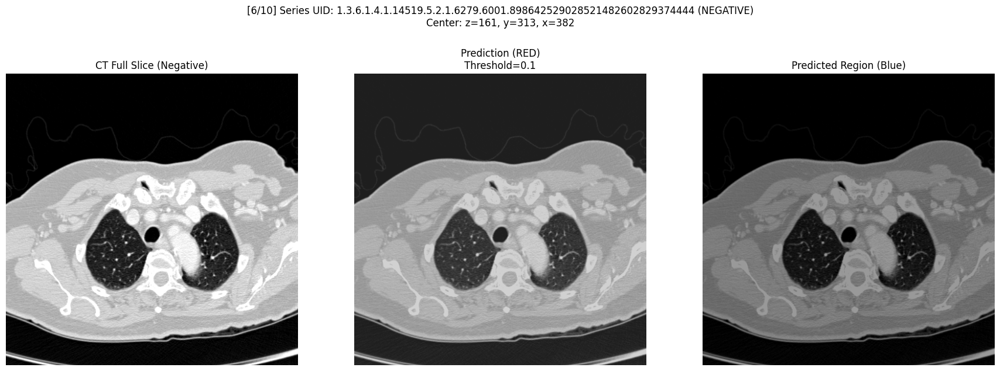

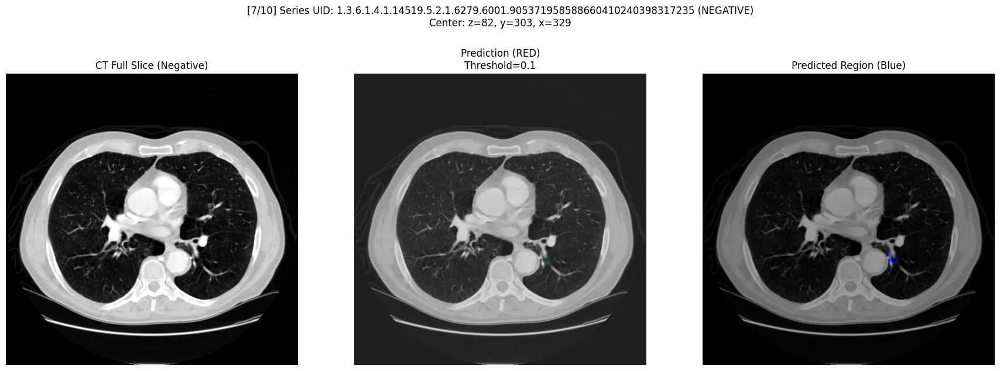

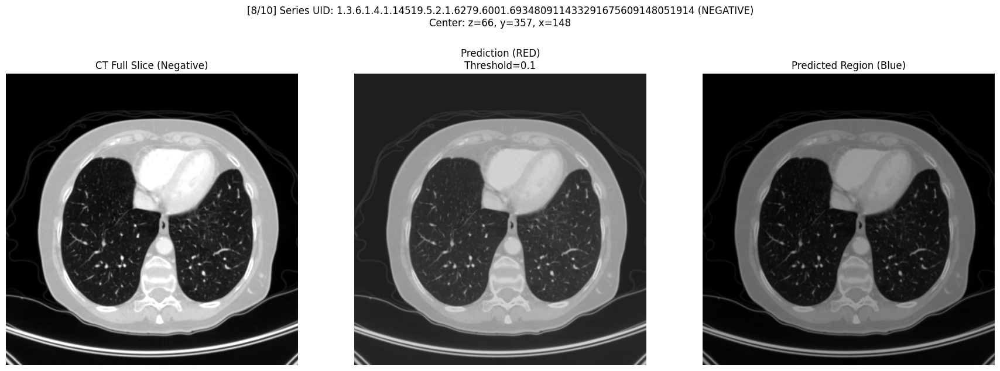

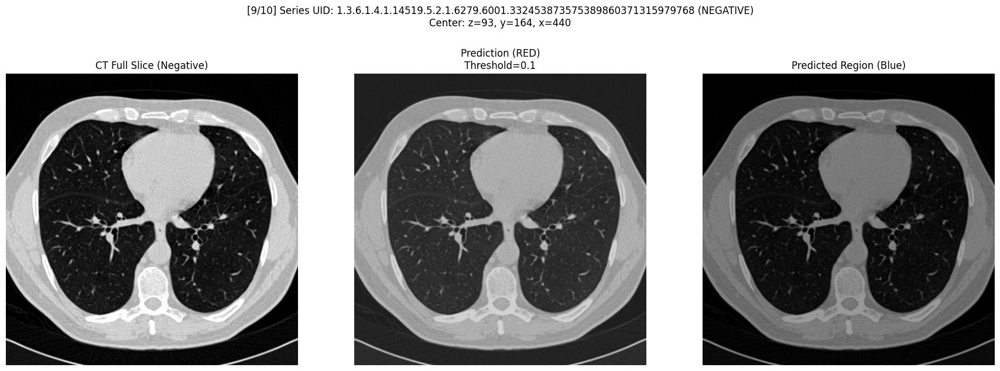

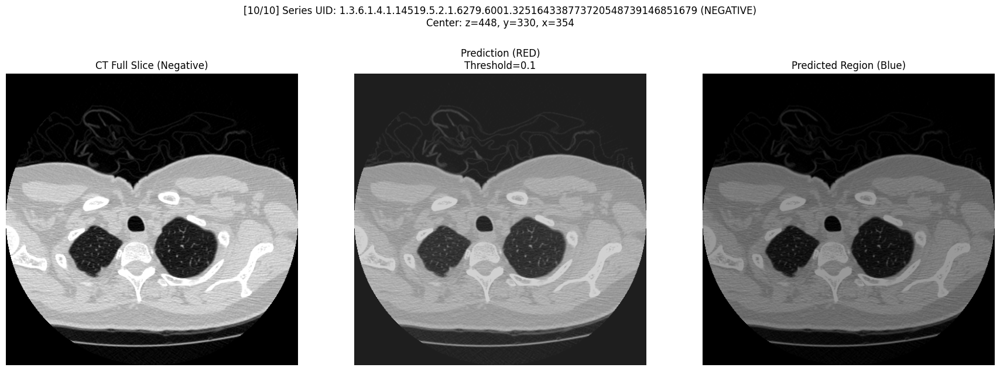

In [19]:
# -------------------------
# 검증셋 음성 후보 리스트
# -------------------------
val_negatives = [
    c for i, c in enumerate(getCandidateInfoList())
    if i % val_stride == 0 and not c.isNodule_bool
]

print(f"[INFO] 검증셋 음성 후보 수: {len(val_negatives)}")

# -------------------------
# 랜덤으로 N개 선택
# -------------------------
selected_negatives = random.sample(val_negatives, min(num_samples, len(val_negatives)))

# -------------------------
# 반복 시각화
# -------------------------
for idx, candidate in enumerate(selected_negatives):
    series_uid = candidate.series_uid
    ct = getCt(series_uid)

    center_irc = xyz2irc(candidate.center_xyz, ct.origin_xyz, ct.vxSize_xyz, ct.direction_a)
    z, y, x = map(int, center_irc)
    ct_slice = ct.hu_a[z]

    # GT 마스크 없음 (비결절)
    gt_mask = np.zeros_like(ct_slice, dtype=np.uint8)

    # 모델 예측
    crop = ct.hu_a[z - 3:z + 4, y - 32:y + 32, x - 32:x + 32]
    input_tensor = torch.from_numpy(crop).unsqueeze(0).to(device)

    model.eval()
    with torch.no_grad():
        pred = model(input_tensor)
        pred_resized = F.interpolate(pred, size=(64, 64), mode='bilinear', align_corners=False)
        pred_mask = pred_resized.squeeze().cpu().numpy() > threshold

    pred_full = np.zeros_like(ct_slice, dtype=np.uint8)
    pred_full[y - 32:y + 32, x - 32:x + 32] = pred_mask

    # 중첩 마스크
    overlay = np.zeros((*ct_slice.shape, 3), dtype=np.uint8)
    overlay[pred_full == 1] = [0, 0, 255]  # 파랑: 오탐 영역

    # 시각화
    fig, axs = plt.subplots(1, 3, figsize=(18, 6))

    axs[0].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
    axs[0].set_title("CT Full Slice (Negative)")

    axs[1].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
    axs[1].imshow(pred_full, cmap='Accent_r', alpha=0.3)
    axs[1].set_title(f"Prediction (RED)\nThreshold={threshold}")

    axs[2].imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
    axs[2].imshow(overlay, alpha=0.4)
    axs[2].set_title("Predicted Region (Blue)")

    for ax in axs:
        ax.axis('off')

    plt.suptitle(f"[{idx+1}/{len(selected_negatives)}] Series UID: {series_uid} (NEGATIVE)\nCenter: z={z}, y={y}, x={x}", y=1.05)
    plt.tight_layout()
    plt.show()

## z,y,x축 슬라이스

In [20]:
# Ct 클래스 객체로부터 HU 배열 추출
hu_tensor = ct.hu_a  # shape: [Z, Y, X], dtype: torch.FloatTensor

# 함수 호출
show_multiview(ct_tensor=hu_tensor, series_uid=series_uid)

NameError: name 'show_multiview' is not defined

In [21]:
def show_multiple_predictions_from_candidates(ct, candidate_list, model, threshold=0.5):
    num_slices = len(candidate_list)
    fig, axs = plt.subplots(1, num_slices, figsize=(6 * num_slices, 6))

    if num_slices == 1:
        axs = [axs]

    for ax, candidate in zip(axs, candidate_list):
        center_irc = xyz2irc(candidate.center_xyz, ct.origin_xyz, ct.vxSize_xyz, ct.direction_a)
        z, y, x = map(int, center_irc)
        ct_slice = ct.hu_a[z]

        # 모델 입력용 crop 생성
        crop = ct.hu_a[z - 3:z + 4, y - 32:y + 32, x - 32:x + 32]  # [7, 64, 64]
        input_tensor = torch.from_numpy(crop).unsqueeze(0).to(next(model.parameters()).device)

        model.eval()
        with torch.no_grad():
            pred = model(input_tensor)  # [1, 1, h, w]
            pred_resized = F.interpolate(pred, size=(64, 64), mode='bilinear', align_corners=False)
            pred_mask = pred_resized.squeeze().cpu().numpy() > threshold

        # 512x512 full mask로 복원
        pred_full = np.zeros_like(ct_slice, dtype=np.uint8)
        pred_full[y - 32:y + 32, x - 32:x + 32] = pred_mask

        # 시각화
        ax.imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
        ax.imshow(pred_full, cmap='Blues', alpha=0.3)
        ax.set_title(f"Z={z}")
        ax.axis('off')

    plt.tight_layout()
    plt.show()

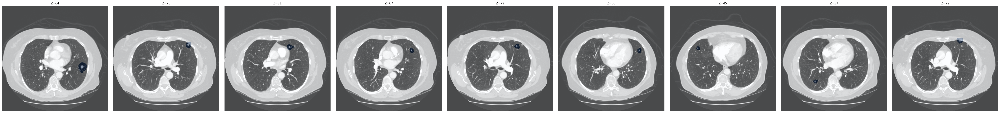

In [22]:
series_uid = "1.3.6.1.4.1.14519.5.2.1.6279.6001.328789598898469177563438457842"
ct = getCt(series_uid)
candidate_list = [c for c in getCandidateInfoList() if c.series_uid == series_uid and c.isNodule_bool]

show_multiple_predictions_from_candidates(ct, candidate_list, model, threshold=0.5)

In [23]:
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn.functional as F
from matplotlib.patches import Rectangle
from util.util import xyz2irc

def show_predictions_with_bbox(ct, candidate_list, model, threshold=0.5):
    """
    결절 중심 기준 예측 + 바운딩 박스 포함 시각화
    """
    num_slices = len(candidate_list)
    fig, axs = plt.subplots(1, num_slices, figsize=(6 * num_slices, 6))

    if num_slices == 1:
        axs = [axs]

    for ax, candidate in zip(axs, candidate_list):
        center_irc = xyz2irc(candidate.center_xyz, ct.origin_xyz, ct.vxSize_xyz, ct.direction_a)
        z, y, x = map(int, center_irc)
        ct_slice = ct.hu_a[z]

        # 모델 예측
        crop = ct.hu_a[z - 3:z + 4, y - 32:y + 32, x - 32:x + 32]  # [7, 64, 64]
        input_tensor = torch.from_numpy(crop).unsqueeze(0).to(next(model.parameters()).device)

        model.eval()
        with torch.no_grad():
            pred = model(input_tensor)  # [1, 1, h, w]
            pred_resized = F.interpolate(pred, size=(64, 64), mode='bilinear', align_corners=False)
            pred_mask = pred_resized.squeeze().cpu().numpy() > threshold

        # 예측 마스크 복원
        pred_full = np.zeros_like(ct_slice, dtype=np.uint8)
        pred_full[y - 32:y + 32, x - 32:x + 32] = pred_mask

        # 시각화
        ax.imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
        ax.imshow(pred_full, cmap='Blues', alpha=0.3)

        # 🔸 바운딩 박스 추가
        bbox = Rectangle(
            (x - 32, y - 32), 64, 64,
            edgecolor='lime', linewidth=2, facecolor='none'
        )
        ax.add_patch(bbox)

        ax.set_title(f"Z={z}")
        ax.axis('off')

    plt.tight_layout()
    plt.show()

In [24]:
def show_bbox_prediction(ct, candidate_list, model, threshold=0.3):
    """
    결절 중심 기준 예측 + GT 박스(빨간), 모델 crop 박스(초록) 시각화
    """
    num_slices = len(candidate_list)
    fig, axs = plt.subplots(1, num_slices, figsize=(4 * num_slices, 4))

    if num_slices == 1:
        axs = [axs]

    for ax, candidate in zip(axs, candidate_list):
        center_irc = xyz2irc(candidate.center_xyz, ct.origin_xyz, ct.vxSize_xyz, ct.direction_a)
        z, y, x = map(int, center_irc)
        ct_slice = ct.hu_a[z]

        # 예측 마스크 얻기
        crop = ct.hu_a[z - 3:z + 4, y - 32:y + 32, x - 32:x + 32]  # [7, 64, 64]
        input_tensor = torch.from_numpy(crop).unsqueeze(0).to(next(model.parameters()).device)

        model.eval()
        with torch.no_grad():
            pred = model(input_tensor)
            pred_resized = F.interpolate(pred, size=(64, 64), mode='bilinear', align_corners=False)
            pred_mask = pred_resized.squeeze().cpu().numpy() > threshold

        # 예측 마스크 복원
        pred_full = np.zeros_like(ct_slice, dtype=np.uint8)
        pred_full[y - 32:y + 32, x - 32:x + 32] = pred_mask

        # 시각화
        ax.imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
        ax.imshow(pred_full, cmap='Blues', alpha=0.3)

        #  GT 박스 (결절 직경 기반)
        r_pixel = max(3, int(candidate.diameter_mm / ct.vxSize_xyz[1]))
        gt_box = Rectangle(
            (x - r_pixel, y - r_pixel), 2*r_pixel, 2*r_pixel,
            edgecolor='red', linewidth=1.5, facecolor='none'
        )
        ax.add_patch(gt_box)

        #  모델 crop 박스 (64x64)
        crop_box = Rectangle(
            (x - 32, y - 32), 64, 64,
            edgecolor='lime', linewidth=1.5, facecolor='none'
        )
        ax.add_patch(crop_box)

        ax.set_title(f"Z={z}")
        ax.axis('off')

    plt.tight_layout()
    plt.show()

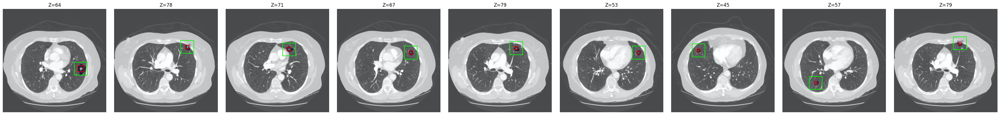

In [25]:
series_uid = "1.3.6.1.4.1.14519.5.2.1.6279.6001.328789598898469177563438457842"
ct = getCt(series_uid)
candidate_list = [c for c in getCandidateInfoList() if c.series_uid == series_uid and c.isNodule_bool]

show_bbox_prediction(ct, candidate_list, model)

In [26]:
def get_bbox_from_mask(mask):
    """
    이진 마스크에서 (y1, x1, y2, x2) 바운딩 박스 좌표 추출
    """
    ys, xs = np.where(mask)
    if len(xs) == 0 or len(ys) == 0:
        return None  # 예측 없음
    y1, y2 = ys.min(), ys.max()
    x1, x2 = xs.min(), xs.max()
    return x1, y1, x2, y2



def show_pred_bbox(ct, candidate_list, model, threshold=0.3):
    from math import ceil
    from matplotlib.patches import Rectangle

    num_slices = len(candidate_list)
    cols = 3
    rows = ceil(num_slices / cols)

    fig, axs = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows))
    axs = axs.flatten()

    for ax, candidate in zip(axs, candidate_list):
        center_irc = xyz2irc(candidate.center_xyz, ct.origin_xyz, ct.vxSize_xyz, ct.direction_a)
        z, y, x = map(int, center_irc)
        ct_slice = ct.hu_a[z]

        # 모델 예측
        crop = ct.hu_a[z - 3:z + 4, y - 32:y + 32, x - 32:x + 32]  # [7, 64, 64]
        input_tensor = torch.from_numpy(crop).unsqueeze(0).to(next(model.parameters()).device)

        model.eval()
        with torch.no_grad():
            pred = model(input_tensor)
            pred_resized = F.interpolate(pred, size=(64, 64), mode='bilinear', align_corners=False)
            pred_mask = (pred_resized.squeeze().cpu().numpy() > threshold).astype(np.uint8)

        # pred_mask → 원래 위치로 복원
        pred_full = np.zeros_like(ct_slice, dtype=np.uint8)
        y1, y2 = y - 32, y + 32
        x1, x2 = x - 32, x + 32
        pred_full[y1:y2, x1:x2] = pred_mask

        # 바운딩 박스
        bbox = get_bbox_from_mask(pred_full)

        # 시각화
        ax.imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
        ax.imshow(pred_full, cmap='Blues', alpha=0.3)

        #  GT 박스
        r_pixel = max(3, int(candidate.diameter_mm / ct.vxSize_xyz[1]))
        gt_box = Rectangle(
            (x - r_pixel, y - r_pixel), 2 * r_pixel, 2 * r_pixel,
            edgecolor='red', linewidth=1.5, facecolor='none'
        )
        ax.add_patch(gt_box)

        #  예측 박스
        if bbox:
            px1, py1, px2, py2 = bbox
            pred_box = Rectangle(
                (px1, py1), px2 - px1, py2 - py1,
                edgecolor='lime', linewidth=1.5, facecolor='none'
            )
            ax.add_patch(pred_box)

        ax.set_title(f"Z = {z}")
        ax.axis('off')

    # 빈 칸은 지우기
    for i in range(num_slices, len(axs)):
        axs[i].axis('off')

    plt.tight_layout()
    plt.show()

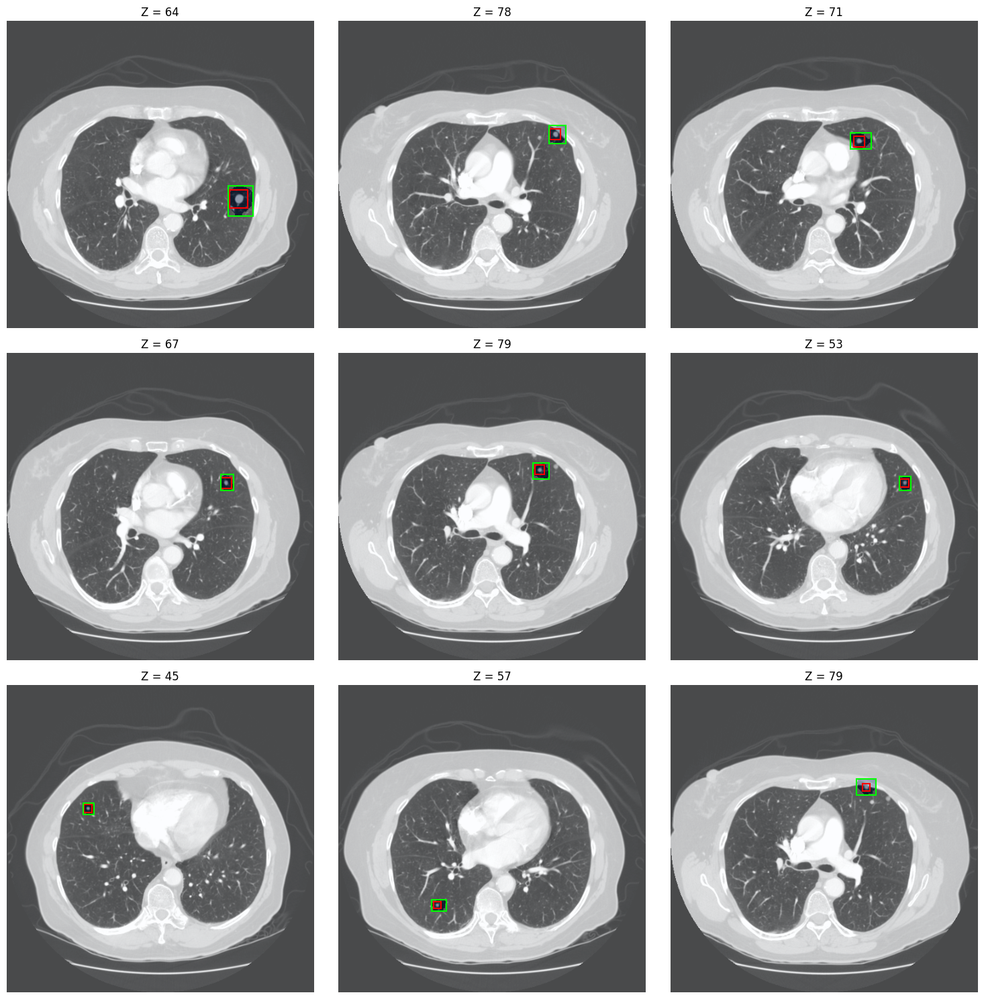

In [27]:
series_uid = "1.3.6.1.4.1.14519.5.2.1.6279.6001.328789598898469177563438457842"
ct = getCt(series_uid)
candidate_list = [c for c in getCandidateInfoList() if c.series_uid == series_uid and c.isNodule_bool]

show_pred_bbox(ct, candidate_list, model)

In [28]:
def get_pred_volume(ct, candidate_list, model, threshold=0.3):
    D, H, W = ct.hu_a.shape
    pred_volume = np.zeros((D, H, W), dtype=np.uint8)

    for candidate in candidate_list:
        center_irc = xyz2irc(candidate.center_xyz, ct.origin_xyz, ct.vxSize_xyz, ct.direction_a)
        z, y, x = map(int, center_irc)

        # crop
        crop = ct.hu_a[z - 3:z + 4, y - 32:y + 32, x - 32:x + 32]
        input_tensor = torch.from_numpy(crop).unsqueeze(0).to(next(model.parameters()).device)

        model.eval()
        with torch.no_grad():
            pred = model(input_tensor)
            pred_resized = F.interpolate(pred, size=(64, 64), mode='bilinear', align_corners=False)
            pred_mask = (pred_resized.squeeze().cpu().numpy() > threshold).astype(np.uint8)

        # 원래 위치에 붙이기
        y1, y2 = y - 32, y + 32
        x1, x2 = x - 32, x + 32
        if 0 <= z < D and y1 >= 0 and y2 <= H and x1 >= 0 and x2 <= W:
            pred_volume[z, y1:y2, x1:x2] = np.maximum(pred_volume[z, y1:y2, x1:x2], pred_mask)

    return pred_volume


def show_3d_prediction(ct_volume, pred_volume, z_list, threshold=0.5):
    from math import ceil
    from scipy.ndimage import zoom
    from matplotlib import pyplot as plt

    num_slices = len(z_list)
    cols = 3
    rows = ceil(num_slices / cols)

    fig, axs = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows))
    axs = axs.flatten()

    h_raw, w_raw = ct_volume.shape[1:]
    h_pred, w_pred = pred_volume.shape[1:]

    for idx, z in enumerate(z_list):
        ax = axs[idx]
        ct_slice = zoom(ct_volume[z], (h_pred / h_raw, w_pred / w_raw), order=1)
        pred_mask = pred_volume[z] > threshold

        ax.imshow(ct_slice, cmap='gray', vmin=-1000, vmax=300)
        ax.imshow(pred_mask, cmap='Blues', alpha=0.3)
        ax.set_title(f"Z = {z}")
        ax.axis('off'

        )

    # 남은 빈 칸은 안 보이게
    for i in range(num_slices, len(axs)):
        axs[i].axis('off')

    plt.tight_layout()
    plt.show()


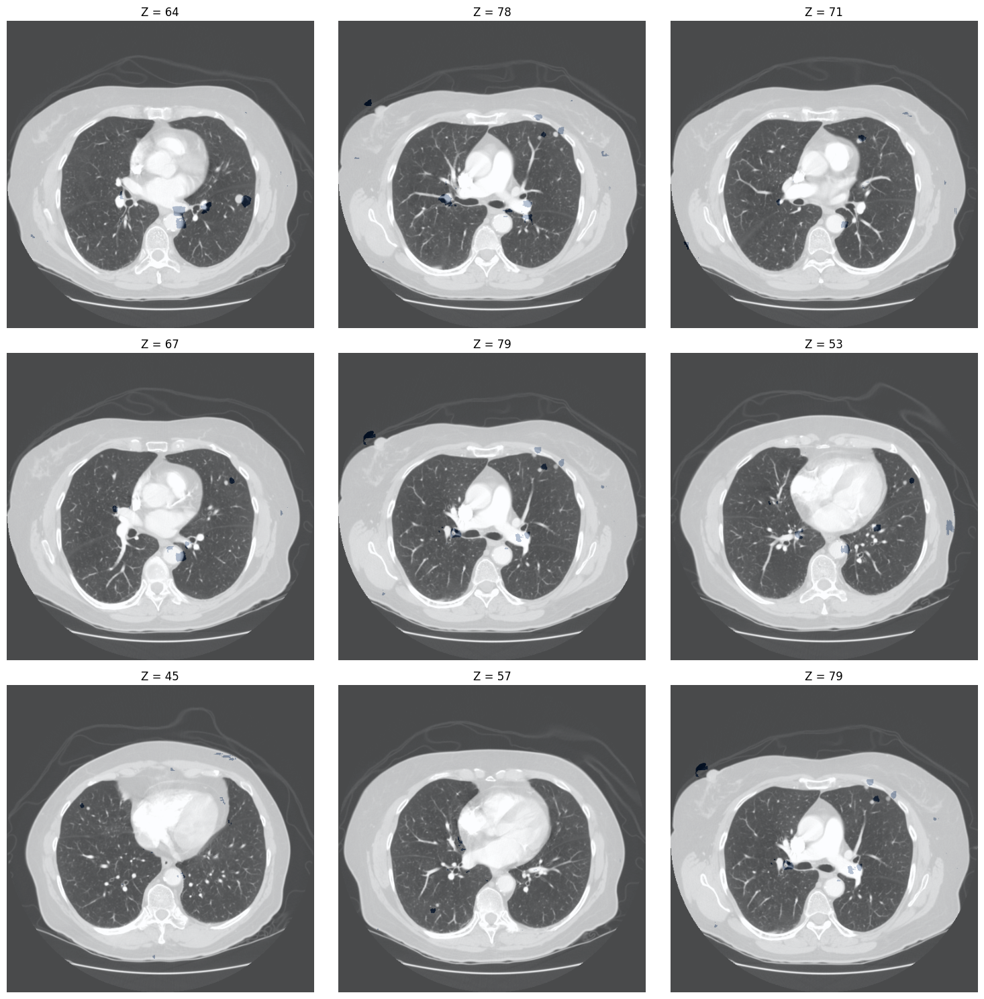

In [43]:
import torch.nn.functional as F
import numpy as np
import torch

z_list = []
for c in candidate_list:
    center_irc = xyz2irc(c.center_xyz, ct.origin_xyz, ct.vxSize_xyz, ct.direction_a)
    z = int(center_irc[0])
    if 0 <= z < ct.hu_a.shape[0]:  # 유효한 범위 내일 때만 추가
        z_list.append(z)
def get_full_volume_prediction(ct, model):
    D, H, W = ct.hu_a.shape
    pred_volume = np.zeros((D, H, W), dtype=np.float32)

    model.eval()
    with torch.no_grad():
        for z in range(3, D - 3):  # 양 끝 제외
            slices = ct.hu_a[z - 3: z + 4]  # 7개 슬라이스
            input_tensor = torch.from_numpy(slices).float().unsqueeze(0).to(next(model.parameters()).device)  # [1, 7, H, W]

            pred = model(input_tensor)  # [1, 1, h', w']
            pred_resized = F.interpolate(pred, size=(H, W), mode='bilinear', align_corners=False)
            pred_np = pred_resized.squeeze().cpu().numpy()  # [H, W]

            pred_volume[z] = pred_np

    return pred_volume
pred_volume = get_full_volume_prediction(ct, model)
binary_volume = (pred_volume > 0.5).astype(np.uint8)

show_3d_prediction(ct.hu_a, pred_volume, z_list, threshold=0.5)

In [59]:
print(candidateInfo_list[0])
print(dir(candidateInfo_list[0]))

CandidateInfoTuple(isNodule_bool=False, hasAnnotation_bool=False, isMal_bool=False, diameter_mm=0.0, series_uid='1.3.6.1.4.1.14519.5.2.1.6279.6001.328789598898469177563438457842', center_xyz=XyzTuple(x=36.80121634575289, y=-145.86052467098045, z=-350.6563143798929))
['__add__', '__class__', '__class_getitem__', '__contains__', '__delattr__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getitem__', '__getnewargs__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__iter__', '__le__', '__len__', '__lt__', '__match_args__', '__module__', '__mul__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__rmul__', '__setattr__', '__sizeof__', '__slots__', '__str__', '__subclasshook__', '_asdict', '_field_defaults', '_fields', '_make', '_replace', 'center_xyz', 'count', 'diameter_mm', 'hasAnnotation_bool', 'index', 'isMal_bool', 'isNodule_bool', 'series_uid']


In [ ]:
from util.util import xyz2irc  # 이거 이미 했으면 생략해도 됨

def show_candidate_grouping(ct, mask_a, candidateInfo_list, slice_idx):
    fig, ax = plt.subplots(figsize=(10, 10))

    # 슬라이스 HU 클리핑해서 표시
    image_slice = np.clip(ct.hu_a[slice_idx], -1000, 1000)
    ax.imshow(image_slice, cmap='gray')

    # 마스크 윤곽선
    ax.contour(mask_a[slice_idx], colors='r', linewidths=0.5)

    # 후보 위치 표시 (xyz → irc 변환 필요)
    for cand in candidateInfo_list:
        center_xyz = cand.center_xyz
        center_irc = xyz2irc(center_xyz, ct.origin, ct.vxSize, ct.direction)  # 핵심
        z, y, x = map(int, center_irc)
        if z == slice_idx:
            ax.plot(x, y, 'bo', markersize=6)
            ax.text(x+2, y+2, f"({x},{y})", color='cyan', fontsize=8)

    ax.set_title(f"Slice {slice_idx} - Candidate Grouping")
    plt.axis('off')
    plt.show()


2025-07-17 15:16:43,426 DEBUG    pid:8732 p2ch14.nodule_analysis:211:initModels data-unversioned/part2/models/p2ch13/seg_2025-07-17_13.42.03_augmented.best.state
2025-07-17 15:16:43,495 DEBUG    pid:8732 p2ch14.nodule_analysis:227:initModels data/part2/models/cls_2020-02-06_14.16.55_final-nodule-nonnodule.best.state


Total slices: 128, Visualizing slice: 64


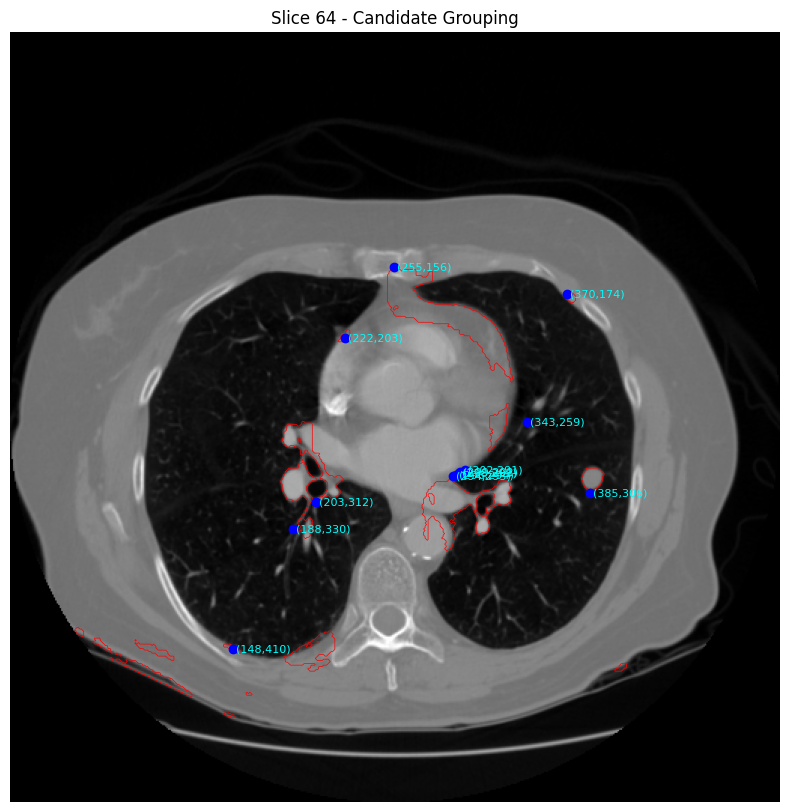

In [64]:
import numpy as np
import matplotlib.pyplot as plt

from p2ch14.nodule_analysis import NoduleAnalysisApp
from p2ch14.dsets import getCt
from util.util import xyz2irc

# 📌 1. 시리즈 UID 및 세그멘테이션 모델 경로
uid = '1.3.6.1.4.1.14519.5.2.1.6279.6001.328789598898469177563438457842'
seg_path = 'data-unversioned/part2/models/p2ch13/seg_2025-07-17_13.42.03_augmented.best.state'

# 📌 2. 분석 객체 생성
app = NoduleAnalysisApp([
    uid,
    '--segmentation-path', seg_path
])

# 📌 3. CT 불러오기
ct = getCt(uid)

# 📌 4. 세그멘테이션 → 마스크 생성
mask_a = app.segmentCt(ct, uid)

# 📌 5. 후보 그룹핑
candidateInfo_list = app.groupSegmentationOutput(uid, ct, mask_a)

# 📌 6. 시각화 함수 정의 (xyz → irc 변환 포함)
def show_candidate_grouping(ct, mask_a, candidateInfo_list, slice_idx):
    fig, ax = plt.subplots(figsize=(10, 10))

    image_slice = np.clip(ct.hu_a[slice_idx], -1000, 1000)
    ax.imshow(image_slice, cmap='gray')
    ax.contour(mask_a[slice_idx], colors='r', linewidths=0.5)

    for cand in candidateInfo_list:
        center_xyz = cand.center_xyz
        center_irc = xyz2irc(center_xyz, ct.origin_xyz, ct.vxSize_xyz, ct.direction_a)
        z, y, x = map(int, center_irc)

        if z == slice_idx:
            ax.plot(x, y, 'bo', markersize=6)
            ax.text(x + 2, y + 2, f"({x},{y})", color='cyan', fontsize=8)

    ax.set_title(f"Slice {slice_idx} - Candidate Grouping")
    plt.axis('off')
    plt.show()

# 📌 7. 중간 슬라이스 시각화
z_max = ct.hu_a.shape[0]
middle_z = z_max // 2
print(f"Total slices: {z_max}, Visualizing slice: {middle_z}")
show_candidate_grouping(ct, mask_a, candidateInfo_list, slice_idx=middle_z)

In [70]:
import pandas as pd
from scipy.spatial.distance import cdist
import numpy as np

# 1. annotations.csv 불러오기
df_ann = pd.read_csv('data/part2/luna/annotations.csv')  # 경로는 너의 위치에 맞게 조정해줘

# 2. 해당 시리즈에 해당하는 GT 결절만 필터링
gt_df = df_ann[df_ann['seriesuid'] == uid]

# 3. GT 결절 중심 좌표 리스트 (Z, Y, X 순서)
gt_xyz_list = list(zip(gt_df['coordZ'], gt_df['coordY'], gt_df['coordX']))  # 순서 주의!
gt_xyz_np = np.array(gt_xyz_list)

# 4. 예측 후보 중심 좌표 리스트
pred_xyz_np = np.array([[c.center_xyz.z, c.center_xyz.y, c.center_xyz.x] for c in candidateInfo_list])

# 5. 거리 행렬 계산
dist_matrix = cdist(gt_xyz_np, pred_xyz_np)

# 6. 가장 가까운 예측 후보와 거리 출력
min_distances = dist_matrix.min(axis=1)
min_indices = dist_matrix.argmin(axis=1)

for i, (gt_xyz, dist, idx) in enumerate(zip(gt_xyz_list, min_distances, min_indices)):
    pred_xyz = pred_xyz_np[idx]
    print(f"[결절 {i+1}]")
    print(f"   GT 좌표       : ({gt_xyz[0]:.2f}, {gt_xyz[1]:.2f}, {gt_xyz[2]:.2f})")
    print(f"   예측 좌표     : ({pred_xyz[0]:.2f}, {pred_xyz[1]:.2f}, {pred_xyz[2]:.2f})")
    print(f"   거리           : {dist:.2f} mm")

[결절 1]
   GT 좌표       : (-223.18, -58.75, 94.69)
   예측 좌표     : (-222.75, -59.13, 95.10)
   거리           : 0.70 mm
[결절 2]
   GT 좌표       : (-196.17, 0.47, 92.33)
   예측 좌표     : (-196.64, 0.73, 92.40)
   거리           : 0.54 mm
[결절 3]
   GT 좌표       : (-188.32, -58.71, 76.37)
   예측 좌표     : (-190.25, -58.69, 76.45)
   거리           : 1.93 mm
[결절 4]
   GT 좌표       : (-177.40, -70.86, 38.18)
   예측 좌표     : (-177.75, -74.60, 56.45)
   거리           : 18.65 mm
[결절 5]
   GT 좌표       : (-160.47, -79.17, 73.40)
   예측 좌표     : (-159.96, -80.31, 74.61)
   거리           : 1.74 mm
[결절 6]
   GT 좌표       : (-158.29, -74.66, 54.10)
   예측 좌표     : (-162.75, -59.58, 48.29)
   거리           : 16.77 mm
[결절 7]
   GT 좌표       : (-157.61, -92.92, 47.40)
   예측 좌표     : (-157.75, -94.36, 47.89)
   거리           : 1.53 mm
[결절 8]
   GT 좌표       : (-243.49, -66.64, -94.14)
   예측 좌표     : (-245.25, -66.03, -94.04)
   거리           : 1.87 mm
[결절 9]
   GT 좌표       : (-212.04, 52.78, -72.47)
   예측 좌표     : (-212.75, 52.78,

C:\Users\ADMIN\AppData\Local\Temp\ipykernel_8732\4274185888.py:28: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


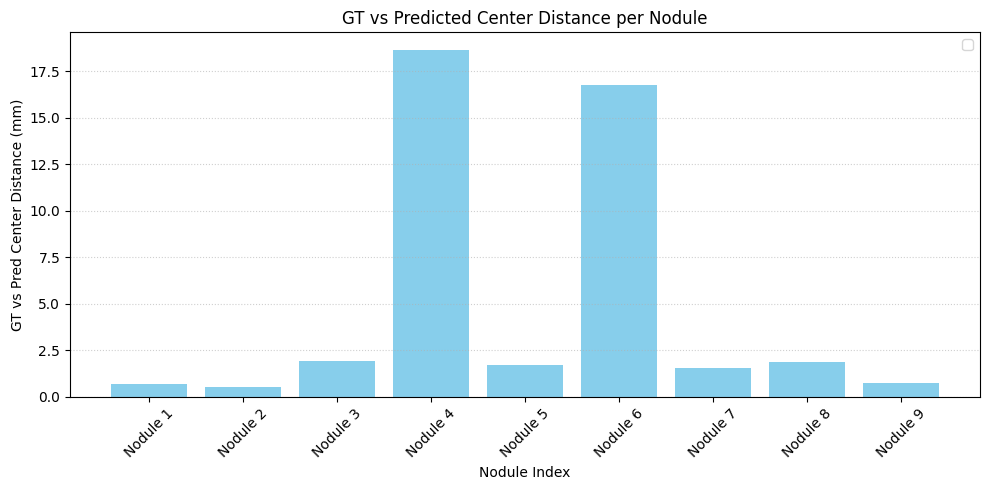

In [74]:
import pandas as pd
import matplotlib.pyplot as plt

# 실제 거리 데이터 (너가 위에 제공한 값)
results = [
    {'gt_xyz': (-223.18, -58.75, 94.69), 'pred_xyz': (-222.75, -59.13, 95.10), 'dist_mm': 0.70},
    {'gt_xyz': (-196.17, 0.47, 92.33), 'pred_xyz': (-196.64, 0.73, 92.40), 'dist_mm': 0.54},
    {'gt_xyz': (-188.32, -58.71, 76.37), 'pred_xyz': (-190.25, -58.69, 76.45), 'dist_mm': 1.93},
    {'gt_xyz': (-177.40, -70.86, 38.18), 'pred_xyz': (-177.75, -74.60, 56.45), 'dist_mm': 18.65},
    {'gt_xyz': (-160.47, -79.17, 73.40), 'pred_xyz': (-159.96, -80.31, 74.61), 'dist_mm': 1.74},
    {'gt_xyz': (-158.29, -74.66, 54.10), 'pred_xyz': (-162.75, -59.58, 48.29), 'dist_mm': 16.77},
    {'gt_xyz': (-157.61, -92.92, 47.40), 'pred_xyz': (-157.75, -94.36, 47.89), 'dist_mm': 1.53},
    {'gt_xyz': (-243.49, -66.64, -94.14), 'pred_xyz': (-245.25, -66.03, -94.04), 'dist_mm': 1.87},
    {'gt_xyz': (-212.04, 52.78, -72.47), 'pred_xyz': (-212.75, 52.78, -72.25), 'dist_mm': 0.75},
]

# DataFrame 변환
df = pd.DataFrame(results)
df.index = [f"Nodule {i+1}" for i in range(len(df))]

# 📊 시각화
plt.figure(figsize=(10, 5))
plt.bar(range(1, len(df)+1), df['dist_mm'], color='skyblue')
plt.xticks(range(1, len(df)+1), df.index, rotation=45)
plt.xlabel("Nodule Index")
plt.ylabel("GT vs Pred Center Distance (mm)")
plt.title("GT vs Predicted Center Distance per Nodule")
plt.legend()
plt.grid(axis='y', linestyle=':', alpha=0.6)
plt.tight_layout()
plt.show()


In [73]:
import pandas as pd

data = [
    [-223.18, -58.75, 94.69, -222.75, -59.13, 95.10, 0.70],
    [-196.17, 0.47, 92.33, -196.64, 0.73, 92.40, 0.54],
    [-188.32, -58.71, 76.37, -190.25, -58.69, 76.45, 1.93],
    [-177.40, -70.86, 38.18, -177.75, -74.60, 56.45, 18.65],
    [-160.47, -79.17, 73.40, -159.96, -80.31, 74.61, 1.74],
    [-158.29, -74.66, 54.10, -162.75, -59.58, 48.29, 16.77],
    [-157.61, -92.92, 47.40, -157.75, -94.36, 47.89, 1.53],
    [-243.49, -66.64, -94.14, -245.25, -66.03, -94.04, 1.87],
    [-212.04, 52.78, -72.47, -212.75, 52.78, -72.25, 0.75],
]

columns = ['GT_Z', 'GT_Y', 'GT_X', 'Pred_Z', 'Pred_Y', 'Pred_X', 'Distance_mm']
df = pd.DataFrame(data, columns=columns)
df.index = [f'Nodule {i+1}' for i in range(len(df))]
df

,GT_Z,GT_Y,GT_X,Pred_Z,Pred_Y,Pred_X,Distance_mm
Nodule 1,-223.18,-58.75,94.69,-222.75,-59.13,95.10,0.70
Nodule 2,-196.17,0.47,92.33,-196.64,0.73,92.40,0.54
Nodule 3,-188.32,-58.71,76.37,-190.25,-58.69,76.45,1.93
Nodule 4,-177.40,-70.86,38.18,-177.75,-74.60,56.45,18.65
Nodule 5,-160.47,-79.17,73.40,-159.96,-80.31,74.61,1.74
Nodule 6,-158.29,-74.66,54.10,-162.75,-59.58,48.29,16.77
Nodule 7,-157.61,-92.92,47.40,-157.75,-94.36,47.89,1.53
Nodule 8,-243.49,-66.64,-94.14,-245.25,-66.03,-94.04,1.87
Nodule 9,-212.04,52.78,-72.47,-212.75,52.78,-72.25,0.75


In [65]:
import numpy as np
from scipy.spatial.distance import cdist

# 1. GT 중심좌표 리스트 추출
gt_xyz_list = [ann.center_xyz for ann in ct.annList]

# 2. 예측된 후보 좌표 리스트
pred_xyz_list = [cand.center_xyz for cand in candidateInfo_list]

# 3. numpy 배열로 변환
gt_xyz_np = np.array([[pt.z, pt.y, pt.x] for pt in gt_xyz_list])  # (Z, Y, X)
pred_xyz_np = np.array([[pt.z, pt.y, pt.x] for pt in pred_xyz_list])

# 4. 거리 계산 (GT x Pred 매트릭스)
distance_matrix = cdist(gt_xyz_np, pred_xyz_np)

# 5. 각 GT 기준 가장 가까운 Pred 거리 계산
min_distances = distance_matrix.min(axis=1)

# 6. 출력
for i, dist in enumerate(min_distances):
    print(f"GT[{i}] 중심 좌표와 가장 가까운 예측 후보까지의 거리: {dist:.2f} mm")

AttributeError: 'Ct' object has no attribute 'annList'

In [33]:
from scipy.ndimage import center_of_mass
from math import sqrt

def compare_gt_pred_centers(ct, candidate_list, pred_volume, threshold=0.3):
    results = []

    for candidate in candidate_list:
        center_irc = xyz2irc(candidate.center_xyz, ct.origin_xyz, ct.vxSize_xyz, ct.direction_a)
        z, y, x = map(int, center_irc)

        pred_mask = pred_volume[z]

        if (pred_mask > threshold).sum() == 0:
            pred_center = None
            distance_pix = None
            distance_mm = None
        else:
            py, px = center_of_mass(pred_mask > threshold)
            pred_center = (int(py), int(px))

            # 거리 (픽셀 단위)
            distance_pix = sqrt((py - y)**2 + (px - x)**2)

            # 거리 (mm 단위) - y, x축 voxel size 적용
            vy, vx = ct.vxSize_xyz[1:3]
            distance_mm = sqrt(((py - y)*vy)**2 + ((px - x)*vx)**2)

        results.append({
            'Z': z,
            'GT_center': (y, x),
            'Pred_center': pred_center,
            'Distance_pix': distance_pix,
            'Distance_mm': distance_mm
        })

    return results


In [36]:
results = compare_gt_pred_centers(ct, candidate_list, pred_volume, threshold=0.3)

for i, r in enumerate(results):
    print(f"[결절 {i+1}] Z = {r['Z']}")
    print(f"   GT 중심:    {r['GT_center']}")
    if r['Pred_center']:
        print(f"   Pred 중심:  {r['Pred_center']}")
        print(f"   거리:       {r['Distance_pix']:.2f} pixels / {r['Distance_mm']:.2f} mm")
    else:
        print(f"   예측 없음")


[결절 1] Z = 64
   GT 중심:    (296, 386)
   Pred 중심:  (297, 388)
   거리:       3.37 pixels / 6.99 mm
[결절 2] Z = 78
   GT 중심:    (188, 361)
   Pred 중심:  (188, 364)
   거리:       3.35 pixels / 8.12 mm
[결절 3] Z = 71
   GT 중심:    (200, 314)
   Pred 중심:  (199, 314)
   거리:       0.64 pixels / 1.56 mm
[결절 4] Z = 67
   GT 중심:    (216, 365)
   Pred 중심:  (216, 366)
   거리:       1.28 pixels / 2.63 mm
[결절 5] Z = 79
   GT 중심:    (194, 335)
   Pred 중심:  (179, 331)
   거리:       14.62 pixels / 13.55 mm
[결절 6] Z = 53
   GT 중심:    (216, 390)
   Pred 중심:  (216, 390)
   거리:       0.63 pixels / 1.52 mm
[결절 7] Z = 45
   GT 중심:    (205, 135)
   Pred 중심:  (205, 136)
   거리:       1.73 pixels / 3.72 mm
[결절 8] Z = 57
   GT 중심:    (366, 164)
   Pred 중심:  (366, 167)
   거리:       3.28 pixels / 8.05 mm
[결절 9] Z = 79
   GT 중심:    (170, 326)
   Pred 중심:  (179, 331)
   거리:       11.27 pixels / 15.78 mm


           Z   GT_center Pred_center  pixel_dist  mm_dist
Nodule 1  64  (296, 386)  (297, 388)        3.37     6.99
Nodule 2  78  (188, 361)  (188, 364)        3.35     8.12
Nodule 3  71  (200, 314)  (199, 314)        0.64     1.56
Nodule 4  67  (216, 365)  (216, 366)        1.28     2.63
Nodule 5  79  (194, 335)  (179, 331)       14.62    13.55
Nodule 6  53  (216, 390)  (216, 390)        0.63     1.52
Nodule 7  45  (205, 135)  (205, 136)        1.73     3.72
Nodule 8  57  (366, 164)  (366, 167)        3.28     8.05
Nodule 9  79  (170, 326)  (179, 331)       11.27    15.78


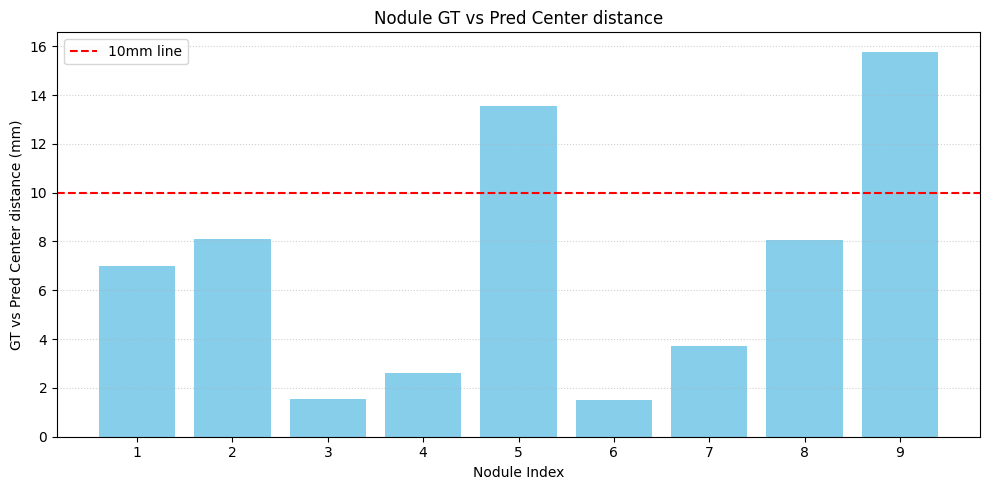

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# 비교 결과 리스트 예시
results = [
    {'Z': 64, 'GT_center': (296, 386), 'Pred_center': (297, 388), 'pixel_dist': 3.37, 'mm_dist': 6.99},
    {'Z': 78, 'GT_center': (188, 361), 'Pred_center': (188, 364), 'pixel_dist': 3.35, 'mm_dist': 8.12},
    {'Z': 71, 'GT_center': (200, 314), 'Pred_center': (199, 314), 'pixel_dist': 0.64, 'mm_dist': 1.56},
    {'Z': 67, 'GT_center': (216, 365), 'Pred_center': (216, 366), 'pixel_dist': 1.28, 'mm_dist': 2.63},
    {'Z': 79, 'GT_center': (194, 335), 'Pred_center': (179, 331), 'pixel_dist': 14.62, 'mm_dist': 13.55},
    {'Z': 53, 'GT_center': (216, 390), 'Pred_center': (216, 390), 'pixel_dist': 0.63, 'mm_dist': 1.52},
    {'Z': 45, 'GT_center': (205, 135), 'Pred_center': (205, 136), 'pixel_dist': 1.73, 'mm_dist': 3.72},
    {'Z': 57, 'GT_center': (366, 164), 'Pred_center': (366, 167), 'pixel_dist': 3.28, 'mm_dist': 8.05},
    {'Z': 79, 'GT_center': (170, 326), 'Pred_center': (179, 331), 'pixel_dist': 11.27, 'mm_dist': 15.78},
]

# 표로 정리
df = pd.DataFrame(results)
df.index = [f"Nodule {i+1}" for i in range(len(df))]
print(df)

# 시각화 (mm 기준 거리)
plt.figure(figsize=(10, 5))
plt.bar(range(1, len(df)+1), df['mm_dist'], color='skyblue')
plt.axhline(y=10, color='red', linestyle='--', label='10mm line')
plt.xticks(range(1, len(df)+1), [f"{i}" for i in range(1, len(df)+1)])
plt.xlabel("Nodule Index")
plt.ylabel("GT vs Pred Center distance (mm)")
plt.title("Nodule GT vs Pred Center distance")
plt.legend()
plt.grid(True, axis='y', linestyle=':', alpha=0.6)
plt.tight_layout()
plt.show()